<a href="https://colab.research.google.com/github/dbarth411/NLF-Object-Detection/blob/master/nfl_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# NFL Helmet Impact Detection

Using a computer vision model to classify helmet impacts in the NFL could be an important step toward improving player safety. The NFL listed this task as a Kaggle competition in attempt to address this need. 

The data provided by the NFL is available directly at this link: https://www.kaggle.com/c/nfl-impact-detection/data. The dataset included 120 training videos with just under 60 frames per second and a corresponding CSV file with information related to each frame, including manually annotated bounding boxes identifying the location of helmets in each frame. 9,947 images along with a corresponding labeled CSV file were also provided as an ancillary dataset to assist with training. 6 test videos were also provided (without a corresponding CSV file). A train and test CSV file with player tracking information was also provided. Breakdown is below:

- 120 Training Videos, Training CSV file (with labeled bounding boxes of helmets and labeled possible impacts)
- 6 Test Videos
- 9947 Training Images, 1280w x 720h, Image Labels CSV file
- Training and Test Player Tracking csv

Detecting helmet impacts is no easy task. Some of the challenges entailed are the smaller sizes of the bounding boxes, accounting for views from both the endzone and the sideline, accounting for player location, distinguishing helmet impacts from other types of impacts, and other complications. An attempt is made at detecting helmet impacts, but there is much further work that can be done to improve this model which will be explained at the end of the notebook. The provided image files and corresponding image label file were not used for this project. Instead, images were captured from frames of a limited set of the video files as arrays and were compressed to a memory cache and encoded as JPEG files (removes the need to write images to file).

RetinaNet is a single-stage object detector that optimizes both speed and accuracy. The majority of the structure used for this project is available as an open source here: https://keras.io/examples/vision/retinanet/. RetinaNet is built with a backbone network called a Feature Pyramid Network (FPN). This is built on top of ResNet, a prebuilt convolutional neural network. For this project, ResNet50 was used, but ResNet101 or ResNet102 could be used in this same structure (but would increase training time significantly). There are two subnetworks, one responsible for object classification (a classification task) and the other for localization of bounding boxes (a regression task). Further details are explained throughout this notebook and in the README.

In [1]:
#Required install for accessing Google cloud data
!pip install fsspec

In [2]:
#Required install for accessing Google cloud data
!pip install gcsfs

In [3]:
# # Required install when factory runtime is reset
# !pip install IPython --upgrade

In [4]:
#Import necessary libraries
import imageio
from PIL import Image
import cv2
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import shutil
import glob
import subprocess
import tqdm
import json
import math

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.image import imread
from matplotlib.patches import Rectangle
%matplotlib inline

#Setting the resolution as provided in the starter notebook on Kaggle
plt.rcParams['figure.dpi'] = 150
from IPython.display import Video, display
from moviepy.editor import VideoFileClip, clips_array

#block those warnings from pandas about setting values on a slice
import warnings
warnings.filterwarnings('ignore')

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2154496/45929032 bytes (4.7%)5767168/45929032 bytes (12.6%)9609216/45929032 bytes (20.9%)13541376/45929032 bytes (29.5%)17457152/45929032 bytes (38.0%)21397504/45929032 bytes (46.6%)25452544/45929032 bytes (55.4%)29458432/45929032 bytes (64.1%)33587200/45929032 bytes (73.1%)37666816/45929032 bytes (82.0%)41689088/45929032 bytes (90.8%)45793280/45929032 bytes (99.7%)

In [5]:
#Import necessary libraries
import numpy as np
import os
import seaborn as sns
import pandas as pd
import random
import itertools
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from tensorflow import image
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img, save_img
from tensorflow.keras.layers import Layer, Flatten, Dropout, Dense, Input, Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.layers import UpSampling2D, ReLU
from tensorflow.keras.models import Model
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.losses import Loss
from keras.utils.vis_utils import plot_model
from keras.utils.np_utils import to_categorical
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix, classification_report
from scipy.optimize import linear_sum_assignment
from keras import models, layers, optimizers, regularizers, Sequential
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.models import load_model
from keras.layers import Conv2D, Flatten, MaxPooling2D, ZeroPadding2D
from pycocotools.coco import COCO
import datetime

In [6]:
#Set random seed
from numpy.random import seed
set_seed = 123
tf.random.set_seed(set_seed)
seed(set_seed)

In [7]:
resolver = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='grpc://' + os.environ['COLAB_TPU_ADDR'])
tf.config.experimental_connect_to_cluster(resolver)
# This is the TPU initialization code that has to be at the beginning.
tf.tpu.experimental.initialize_tpu_system(resolver)
print("All devices: ", tf.config.list_logical_devices('TPU'))

INFO:tensorflow:Initializing the TPU system: grpc://10.47.220.226:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.47.220.226:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


All devices:  [LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:7', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:6', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:5', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:4', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:3', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:0', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:1', device_type='TPU'), LogicalDevice(name='/job:worker/replica:0/task:0/device:TPU:2', device_type='TPU')]


In [8]:
strategy = tf.distribute.TPUStrategy(resolver)

INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


In [9]:
from google.colab import auth
auth.authenticate_user()

In [10]:
#Required initial install for access to Google Cloud data
# !curl https://sdk.cloud.google.com | bash

In [11]:
#Initiate Google Cloud
!gcloud init

Welcome! This command will take you through the configuration of gcloud.

Settings from your current configuration [default] are:
component_manager:
  disable_update_check: 'True'
compute:
  gce_metadata_read_timeout_sec: '0'
core:
  account: dbarth411@gmail.com

Pick configuration to use:
 [1] Re-initialize this configuration [default] with new settings 
 [2] Create a new configuration
Please enter your numeric choice:  1

Your current configuration has been set to: [default]

You can skip diagnostics next time by using the following flag:
  gcloud init --skip-diagnostics

Network diagnostic detects and fixes local network connection issues.
Reachability Check passed.
Network diagnostic passed (1/1 checks passed).

Choose the account you would like to use to perform operations for 
this configuration:
 [1] dbarth411@gmail.com
 [2] Log in with a new account
Please enter your numeric choice:  1

You are logged in as: [dbarth411@gmail.com].

Pick cloud project to use: 
 [1] nfl-object-de

In [12]:
#Read train_labels file as CSV
video_labels = pd.read_csv("gs://nfl-object-detection123/train/train_labels.csv")

The below function parses tensorflow records into a dictionary and is a necessary step prior to training the model.

In [13]:
def parse(tfrecord):
    "Parse the features of a tensorflow record into a dictionary."
    
    features={
    'image': tf.io.FixedLenFeature([], tf.string),
    'height': tf.io.FixedLenFeature([], tf.int64),
    'width': tf.io.FixedLenFeature([], tf.int64),
    'id': tf.io.FixedLenFeature([], tf.int64),
    'file_name': tf.io.FixedLenFeature([], tf.string),
    'objects': tf.io.FixedLenFeature([], tf.int64),
    'category_ids': tf.io.VarLenFeature(tf.int64),
    'bboxes': tf.io.VarLenFeature(tf.float32),
    'iscrowd': tf.io.VarLenFeature(tf.int64),
    'annotation_ids': tf.io.VarLenFeature(tf.int64)
    }
    
    sample = tf.io.parse_example(tfrecord, features)
    image = tf.image.decode_png(sample['image'], channels=3)
    file_name = sample['file_name']
    objects = sample['objects']
    bboxes = sample['bboxes']
    bboxes = tf.sparse.to_dense(bboxes)
    bboxes = tf.reshape(bboxes, [objects, 4])
    annotation_ids = sample['annotation_ids']
    iscrowd = sample['iscrowd']
    iscrowd = tf.sparse.to_dense(iscrowd)
    category_ids = sample['category_ids']
    category_ids = tf.sparse.to_dense(category_ids)
    
    image_dict = {"image": image, 
                  "image/filename": file_name, 
                  "objects": {"bbox": bboxes, "id": annotation_ids, "iscrowd": iscrowd, "label": category_ids}
                 }
    
    return image_dict

In [14]:
#If desired, copy the train tfrecord to local
# !gsutil cp -r gs://nfl-object-detection123/coco0.tfrecord .

In [15]:
#If desired, copy the test tfrecord to local
# !gsutil cp -r gs://nfl-object-detection123/coco1.tfrecord .

In [16]:
# !gsutil cp coco0.tfrecord gs://nfl-object-detection123/

In [17]:
# !gsutil cp coco1.tfrecord gs://nfl-object-detection123/

In [18]:
train_path = "gs://nfl-object-detection123/coco0.tfrecord"
test_path = "gs://nfl-object-detection123/coco1.tfrecord"

In [19]:
train_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(train_path))
test_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(test_path))

In [20]:
#Parse the dataset
train_dataset = train_dataset.map(parse)
test_dataset = test_dataset.map(parse)

In [21]:
#Preview a row in the dataset
for i in train_dataset.take(1):
  print(i)

{'image': <tf.Tensor: shape=(720, 1280, 3), dtype=uint8, numpy=
array([[[ 42,  72,  20],
        [ 78, 108,  56],
        [ 81, 111,  59],
        ...,
        [ 79, 105,  58],
        [ 81, 107,  60],
        [ 37,  63,  16]],

       [[ 44,  74,  22],
        [ 81, 111,  59],
        [ 85, 115,  63],
        ...,
        [ 79, 105,  58],
        [ 82, 108,  61],
        [ 37,  63,  16]],

       [[ 41,  71,  19],
        [ 78, 108,  56],
        [ 84, 114,  60],
        ...,
        [ 81, 107,  60],
        [ 84, 110,  63],
        [ 39,  65,  18]],

       ...,

       [[ 66,  23,  16],
        [ 71,  28,  19],
        [ 90,  46,  37],
        ...,
        [137,  81,  58],
        [123,  67,  44],
        [ 88,  34,  10]],

       [[ 66,  23,  16],
        [ 71,  28,  19],
        [ 91,  47,  38],
        ...,
        [137,  81,  56],
        [122,  66,  43],
        [ 87,  33,   9]],

       [[ 66,  23,  16],
        [ 71,  28,  19],
        [ 92,  48,  39],
        ...,
        [1

Repeating the same process for the test dataset below.

In [22]:
#Preview the dataset
for i in test_dataset.take(1):
    print(i)

{'image': <tf.Tensor: shape=(720, 1280, 3), dtype=uint8, numpy=
array([[[ 37,  60,   8],
        [ 86, 109,  57],
        [ 85, 108,  54],
        ...,
        [ 78,  79,  61],
        [ 62,  63,  45],
        [ 40,  41,  23]],

       [[ 37,  60,   8],
        [ 82, 105,  53],
        [ 84, 107,  53],
        ...,
        [ 79,  80,  62],
        [ 64,  65,  47],
        [ 44,  45,  27]],

       [[ 44,  67,  15],
        [ 83, 106,  54],
        [ 83, 106,  52],
        ...,
        [ 75,  78,  57],
        [ 60,  63,  42],
        [ 40,  43,  22]],

       ...,

       [[ 35,  48,  18],
        [ 80,  96,  59],
        [ 81,  99,  49],
        ...,
        [ 78, 110,  45],
        [ 71, 102,  43],
        [ 38,  69,  12]],

       [[ 34,  49,  18],
        [ 79,  95,  58],
        [ 80,  98,  48],
        ...,
        [ 76, 108,  43],
        [ 67,  98,  39],
        [ 35,  66,   9]],

       [[ 38,  53,  22],
        [ 82,  98,  61],
        [ 80, 100,  49],
        ...,
        [ 

The following section was originally taken from https://keras.io/examples/vision/retinanet/ and modified where necessary to fit this dataset.

# Utility Functions

Multiple formats for bounding boxes are required for building the model, so below we are implementing functions to convert between formats. 

In [23]:
def swap_xy(boxes):
    """Swaps order the of x and y coordinates of the boxes.

    Arguments:
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes.

    Returns:
      swapped boxes with shape same as that of boxes.
    """
    return tf.stack([boxes[:, 1], boxes[:, 0], boxes[:, 3], boxes[:, 2]], axis=-1)


def convert_to_xywh(boxes):
    """Changes the box format to center, width and height.

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[xmin, ymin, xmax, ymax]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [(boxes[..., :2] + boxes[..., 2:]) / 2.0, boxes[..., 2:] - boxes[..., :2]],
        axis=-1,
    )


def convert_to_corners(boxes):
    """Changes the box format to corner coordinates

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[x, y, width, height]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [boxes[..., :2] - boxes[..., 2:] / 2.0, boxes[..., :2] + boxes[..., 2:] / 2.0],
        axis=-1,
    )

# Compute IOU and Visualize Detections

### Computing IOU (Intersection Over Union):
Intersection over union is the calculation of the overlap of anchor boxes (which will be implemented later) to ground truth boxes (our original annotations). It is calculated as the area where an anchor box intersects with the ground truth box, divided by the combined total area of the anchor box and ground truth box minus the intersecting area.


### Visualizing Detections:
The visualize_detections function was modified from the original open source to include a combination of bounding boxes that intersect within 15 pixels. The bounding boxes that intersect within 15 pixels are labeled as impacts. Again, this was an attempt with using views from the endzone alone, and will not prove to be overly accurate since we are not accounting for player location, just the location of helmets in the image of a single view.

In [24]:
#Create directory for saving plots/images
!mkdir 'saved_images/'

In [25]:
def compute_iou(boxes1, boxes2):
    """Computes pairwise IOU matrix for given two sets of boxes

    Arguments:
      boxes1: A tensor with shape `(N, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.
        boxes2: A tensor with shape `(M, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.

    Returns:
      pairwise IOU matrix with shape `(N, M)`, where the value at ith row
        jth column holds the IOU between ith box and jth box from
        boxes1 and boxes2 respectively.
    """
    boxes1_corners = convert_to_corners(boxes1)
    boxes2_corners = convert_to_corners(boxes2)
    lu = tf.maximum(boxes1_corners[:, None, :2], boxes2_corners[:, :2])
    rd = tf.minimum(boxes1_corners[:, None, 2:], boxes2_corners[:, 2:])
    intersection = tf.maximum(0.0, rd - lu)
    intersection_area = intersection[:, :, 0] * intersection[:, :, 1]
    boxes1_area = boxes1[:, 2] * boxes1[:, 3]
    boxes2_area = boxes2[:, 2] * boxes2[:, 3]
    union_area = tf.maximum(
        boxes1_area[:, None] + boxes2_area - intersection_area, 1e-8
    )
    return tf.clip_by_value(intersection_area / union_area, 0.0, 1.0)

def get_iou(array1, array2, epsilon=1e-5):
    """ Given two boxes `a` and `b` defined as a list of four numbers:
            [x1,y1,x2,y2]
        where:
            x1,y1 represent the upper left corner
            x2,y2 represent the lower right corner
        It returns the Intersect of Union score for these two boxes.

    Args:
        a:          (list of 4 numbers) [x1,y1,x2,y2]
        b:          (list of 4 numbers) [x1,y1,x2,y2]
        epsilon:    (float) Small value to prevent division by zero

    Returns:
        (float) The Intersect of Union score.
    """
    # COORDINATES OF THE INTERSECTION BOX
    x1 = max(array1[0], array2[0])
    y1 = max(array1[1], array2[1])
    x2 = min(array1[2], array2[2])
    y2 = min(array1[3], array2[3])

    # AREA OF OVERLAP - Area where the boxes intersect
    width = (x2 - x1)
    height = (y2 - y1)
    # handle case where there is NO overlap
    if (width<0) or (height <0):
        return 0.0
    area_overlap = width * height

    # COMBINED AREA
    area_a = (array1[2] - array1[0]) * (array1[3] - array1[1])
    area_b = (array2[2] - array2[0]) * (array2[3] - array2[1])
    area_combined = area_a + area_b - area_overlap

    # RATIO OF AREA OF OVERLAP OVER COMBINED AREA
    iou = area_overlap / (area_combined+epsilon)
    return iou


def rect_distance(array_1, array_2):
    x1_center = (array_1[0] + array_1[2]) / 2
    y1_center = (array_1[1] + array_1[3]) / 2
    x2_center = (array_2[0] + array_2[2]) / 2
    y2_center = (array_2[1] + array_2[3]) / 2
    return np.sqrt((x2_center - x1_center)**2 + (y2_center - y1_center)**2)

def visualize_detections(
    image, boxes, classes, scores, min_iou, max_iou,
    figsize=(14, 14), linewidth=1, color='aqua', color_with_impact='orange'
):
    """Visualize Detections.
    
    Arguments:
      image: Prepared image array.
      boxes: Predicted bounding boxes.
      classes: Predicted class labels.
      scores: Predicted confidence scores.
    Returns:
      Image with predicted bounding boxes with helmets as green and impacts as red.
    
    """
    image = np.array(image, dtype=np.uint8)
    plt.figure(figsize=figsize)
    plt.imshow(image)
    ax = plt.gca()
    
    #Iterating through all possible combinations of bounding boxes within each image and defining intersections
    combo_list = []
    for a, b in itertools.combinations(boxes, 2):
        distance = np.abs(rect_distance(a, b))
        iou = get_iou(a, b)
        if ((iou >= min_iou) & (iou <= max_iou)):
            combo_list.append(a)
            combo_list.append(b)

    combo_list = np.array(combo_list)

    labels = scores.tolist()
    for i, j in enumerate(labels):
        if j == 0.:
            labels[i] = 'helmet'
        else:
            labels[i] = 'none'
    classes = labels
                
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format('helmet', score)
        text_with_impact = "{}: {:.2f}".format('IMPACT', score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        patch_with_impact = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color_with_impact, linewidth=2
        )

        if box in combo_list:
            ax.add_patch(patch_with_impact)
            ax.text(x1, y1, text_with_impact, bbox={"facecolor": None, "alpha": 0.0}, 
                    clip_box=ax.clipbox, clip_on=True, color='white', fontweight='medium')
        else:
            ax.add_patch(patch)
            ax.text(x1, y1, text, bbox={"facecolor": None, "alpha": 0.0}, 
                    clip_box=ax.clipbox, clip_on=True, color='white', fontweight='medium') 
    plt.savefig('saved_images/visualize_detections.png')   
    plt.show()
    return ax

# Create Anchor Boxes

A description of anchor boxes is available in the open source project and is quoted below:

"Anchor boxes are fixed sized boxes that the model uses to predict the bounding box for an object. It does this by regressing the offset between the location of the object's center and the center of an anchor box, and then uses the width and height of the anchor box to predict a relative scale of the object. In the case of RetinaNet, each location on a given feature map has nine anchor boxes (at three scales and three ratios)."

Below we are printing the stats for both width and height of our ground truth boxes to get an idea of how we can implement specialized anchor boxes for this particular dataset.

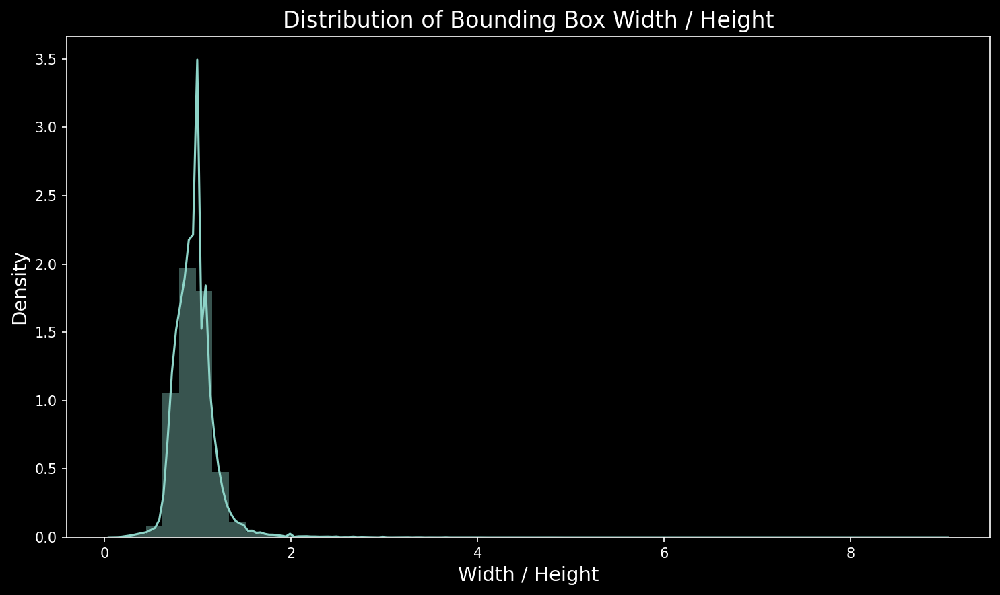

In [26]:
#Preview the distribution of bounding box width
with plt.style.context('dark_background'):
    plt.figure(figsize=(10, 6))
    sns.distplot(video_labels.width / video_labels.height)
    plt.title('Distribution of Bounding Box Width / Height', fontsize=16)
    plt.xlabel('Width / Height', fontsize=14)
    plt.ylabel('Density', fontsize=14)
    plt.savefig("saved_images/width_div_height.png")
    plt.tight_layout()
    plt.show()

Plotting Width / Height helps determine that the majority of bounding boxes are relatively square, so keeping the aspect ratios at 0.5, 1.0, and 1.5 would cover most of the ratios appropriately.

In [27]:
(video_labels.width * video_labels.height).describe()

count    983885.000000
mean        602.598253
std         567.668487
min           9.000000
25%         204.000000
50%         440.000000
75%         777.000000
max        5928.000000
dtype: float64

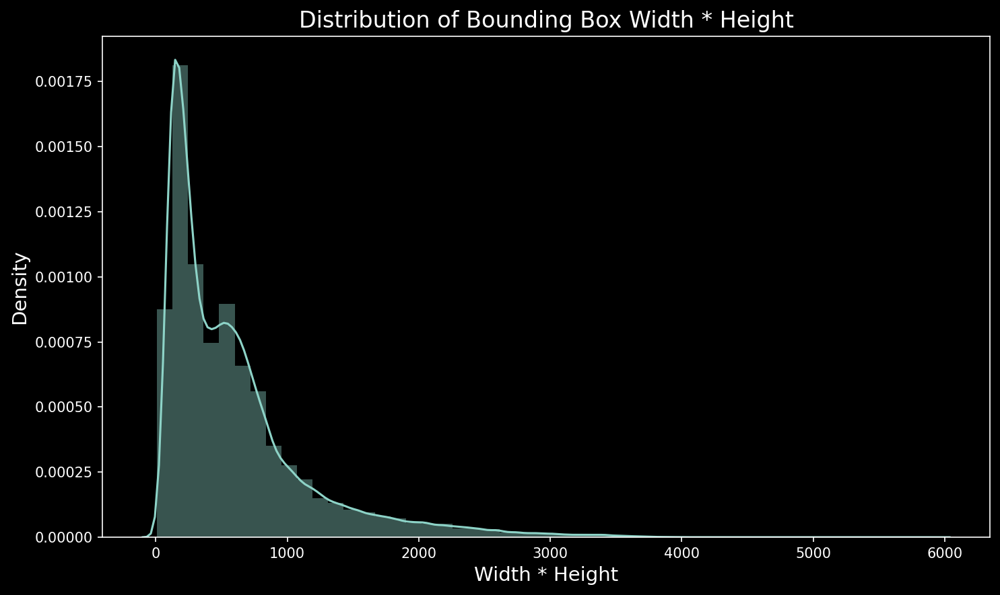

In [28]:
#Preview the distribution of bounding box width
with plt.style.context('dark_background'):
    plt.figure(figsize=(10, 6))
    sns.distplot(video_labels.width * video_labels.height)
    plt.title('Distribution of Bounding Box Width * Height', fontsize=16)
    plt.xlabel('Width * Height', fontsize=14)
    plt.ylabel('Density', fontsize=14)
    plt.savefig('saved_images/width_x_height.png')
    plt.tight_layout()
    plt.show()

Plotting the width x height gives us a general idea of the areas of the bounding boxes. Scales were left the same as the open source project (2^x for x in 0, 1/3, 2/3). The original areas were set to x^2 for x in [32, 64, 128, 256, 512]. Since the helmets in most cases are very small objects, the areas were divided in half and set to x^2 for x in [16, 32, 64, 128, 256].

In [29]:
class AnchorBox:
    """Generates anchor boxes.

    This class has operations to generate anchor boxes for feature maps at
    strides `[8, 16, 32, 64, 128]`. Where each anchor each box is of the
    format `[x, y, width, height]`.

    Attributes:
      aspect_ratios: A list of float values representing the aspect ratios of
        the anchor boxes at each location on the feature map
      scales: A list of float values representing the scale of the anchor boxes
        at each location on the feature map.
      num_anchors: The number of anchor boxes at each location on feature map
      areas: A list of float values representing the areas of the anchor
        boxes for each feature map in the feature pyramid.
      strides: A list of float value representing the strides for each feature
        map in the feature pyramid.
    """

    def __init__(self):
        self.aspect_ratios = [0.5, 1.0, 1.5]
        self.scales = [2 ** x for x in [0, 1/3, 2/3]]

        self._num_anchors = len(self.aspect_ratios) * len(self.scales)
        self._strides = [2 ** i for i in range(3, 8)]
        self._areas = [x ** 2 for x in range(12, 61, 12)]
        self._anchor_dims = self._compute_dims()

    def _compute_dims(self):
        """Computes anchor box dimensions for all ratios and scales at all levels
        of the feature pyramid.
        """
        anchor_dims_all = []
        for area in self._areas:
            anchor_dims = []
            for ratio in self.aspect_ratios:
                anchor_height = tf.math.sqrt(area / ratio)
                anchor_width = area / anchor_height
                dims = tf.reshape(
                    tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
                )
                for scale in self.scales:
                    anchor_dims.append(scale * dims)
            anchor_dims_all.append(tf.stack(anchor_dims, axis=-2))
        return anchor_dims_all

    def _get_anchors(self, feature_height, feature_width, level):
        """Generates anchor boxes for a given feature map size and level

        Arguments:
          feature_height: An integer representing the height of the feature map.
          feature_width: An integer representing the width of the feature map.
          level: An integer representing the level of the feature map in the
            feature pyramid.

        Returns:
          anchor boxes with the shape
          `(feature_height * feature_width * num_anchors, 4)`
        """
        rx = tf.range(feature_width, dtype=tf.float32) + 0.5
        ry = tf.range(feature_height, dtype=tf.float32) + 0.5
        centers = tf.stack(tf.meshgrid(rx, ry), axis=-1) * self._strides[level - 3]
        centers = tf.expand_dims(centers, axis=-2)
        centers = tf.tile(centers, [1, 1, self._num_anchors, 1])
        dims = tf.tile(
            self._anchor_dims[level - 3], [feature_height, feature_width, 1, 1]
        )
        anchors = tf.concat([centers, dims], axis=-1)
        return tf.reshape(
            anchors, [feature_height * feature_width * self._num_anchors, 4]
        )

    def get_anchors(self, image_height, image_width):
        """Generates anchor boxes for all the feature maps of the feature pyramid.

        Arguments:
          image_height: Height of the input image.
          image_width: Width of the input image.

        Returns:
          anchor boxes for all the feature maps, stacked as a single tensor
            with shape `(total_anchors, 4)`
        """
        anchors = [
            self._get_anchors(
                tf.math.ceil(image_height / 2 ** i),
                tf.math.ceil(image_width / 2 ** i),
                i,
            )
            for i in range(3, 8)
        ]
        return tf.concat(anchors, axis=0)

# Preprocess Data

Random_flip_horizontal is a data augmentation technique, randomly flipping images and bounding box annotations.

Since all images are of the same size, the resize_and_pad_image values were changed to match the width of 1280 and height of 720, so the final ratio that is returned is 1.0. If images were of different sizes, this would ensure that all images are resized and padded to similar sizes for model training. Stride was left at 128.0.

The preprocess_data function is used to combine both previous functions along with our utility functions for an efficient input pipeline.

In [30]:
def random_flip_horizontal(image, boxes):
    """Flips image and boxes horizontally with 50% chance

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes,
        having normalized coordinates.

    Returns:
      Randomly flipped image and boxes
    """
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        boxes = tf.stack(
            [1 - boxes[:, 2], boxes[:, 1], 1 - boxes[:, 0], boxes[:, 3]], axis=-1
        )
    return image, boxes


def resize_and_pad_image(
    image, min_side=720.0, max_side=1280.0,
    jitter=[720.0, 1280.0], stride=128.0
):
    """Resizes and pads image while preserving aspect ratio.

    1. Resizes images so that the shorter side is equal to `min_side`
    2. If the longer side is greater than `max_side`, then resize the image
      with longer side equal to `max_side`
    3. Pad with zeros on right and bottom to make the image shape divisible by
    `stride`

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      min_side: The shorter side of the image is resized to this value, if
        `jitter` is set to None.
      max_side: If the longer side of the image exceeds this value after
        resizing, the image is resized such that the longer side now equals to
        this value.
      jitter: A list of floats containing minimum and maximum size for scale
        jittering. If available, the shorter side of the image will be
        resized to a random value in this range.
      stride: The stride of the smallest feature map in the feature pyramid.
        Can be calculated using `image_size / feature_map_size`.

    Returns:
      image: Resized and padded image.
      image_shape: Shape of the image before padding.
      ratio: The scaling factor used to resize the image
    """
    image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.float32)
    if jitter is not None:
        min_side = tf.random.uniform((), jitter[0], jitter[1], dtype=tf.float32)
    ratio = min_side / tf.reduce_min(image_shape)
    if ratio * tf.reduce_max(image_shape) > max_side:
        ratio = max_side / tf.reduce_max(image_shape)
    image_shape = ratio * image_shape
    image = tf.image.resize(image, tf.cast(image_shape, dtype=tf.int32))
    padded_image_shape = tf.cast(
        tf.math.ceil(image_shape / stride) * stride, dtype=tf.int32
    )
    image = tf.image.pad_to_bounding_box(
        image, 0, 0, padded_image_shape[0], padded_image_shape[1]
    )
    return image, image_shape, ratio


def preprocess_data(sample):
    """Applies preprocessing step to a single sample

    Arguments:
      sample: A dict representing a single training sample.

    Returns:
      image: Resized and padded image with random horizontal flipping applied.
      bbox: Bounding boxes with the shape `(num_objects, 4)` where each box is
        of the format `[x, y, width, height]`.
      class_id: An tensor representing the class id of the objects, having
        shape `(num_objects,)`.
    """
    image = sample["image"]
    bbox = swap_xy(sample["objects"]["bbox"])
    class_id = tf.cast(sample["objects"]["label"], dtype=tf.int32)

    image, bbox = random_flip_horizontal(image, bbox)
    image, image_shape, _ = resize_and_pad_image(image)

    bbox = tf.stack(
        [
            bbox[:, 0] * image_shape[1],
            bbox[:, 1] * image_shape[0],
            bbox[:, 2] * image_shape[1],
            bbox[:, 3] * image_shape[0],
        ],
        axis=-1,
    )
    bbox = convert_to_xywh(bbox)
    return image, bbox, class_id

# Encode Labels

As quoted from the original open source project:

"The raw labels, consisting of bounding boxes and class ids need to be transformed into targets for training. This transformation consists of the following steps:

- Generating anchor boxes for the given image dimensions
- Assigning ground truth boxes to the anchor boxes
- The anchor boxes that are not assigned any objects, are either assigned the background class or ignored depending on the IOU
- Generating the classification and regression targets using anchor boxes"

The match IOU threshold was altered to 0.4 and ignore threshold to 0.3. This entails the following:

- An anchor box with an IOU threshold less than 0.3 is considered background and the class label predicted is 0.
- If the anchor box predicts an object with an IOU less than 0.3, it is penalized by the loss function
- An anchor box with an IOU threshold between 0.3 and 0.4 is ignored by the loss function entirely.

In [31]:
class LabelEncoder:
    """Transforms the raw labels into targets for training.

    This class has operations to generate targets for a batch of samples which
    is made up of the input images, bounding boxes for the objects present and
    their class ids.

    Attributes:
      anchor_box: Anchor box generator to encode the bounding boxes.
      box_variance: The scaling factors used to scale the bounding box targets.
    """

    def __init__(self):
        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _match_anchor_boxes(
        self, anchor_boxes, gt_boxes, match_iou=0.3, ignore_iou=0.2
    ):
        """Matches ground truth boxes to anchor boxes based on IOU.

        1. Calculates the pairwise IOU for the M `anchor_boxes` and N `gt_boxes`
          to get a `(M, N)` shaped matrix.
        2. The ground truth box with the maximum IOU in each row is assigned to
          the anchor box provided the IOU is greater than `match_iou`.
        3. If the maximum IOU in a row is less than `ignore_iou`, the anchor
          box is assigned with the background class.
        4. The remaining anchor boxes that do not have any class assigned are
          ignored during training.

        Arguments:
          anchor_boxes: A float tensor with the shape `(total_anchors, 4)`
            representing all the anchor boxes for a given input image shape,
            where each anchor box is of the format `[x, y, width, height]`.
          gt_boxes: A float tensor with shape `(num_objects, 4)` representing
            the ground truth boxes, where each box is of the format
            `[x, y, width, height]`.
          match_iou: A float value representing the minimum IOU threshold for
            determining if a ground truth box can be assigned to an anchor box.
          ignore_iou: A float value representing the IOU threshold under which
            an anchor box is assigned to the background class.

        Returns:
          matched_gt_idx: Index of the matched object
          positive_mask: A mask for anchor boxes that have been assigned ground
            truth boxes.
          ignore_mask: A mask for anchor boxes that need to by ignored during
            training
        """
        iou_matrix = compute_iou(anchor_boxes, gt_boxes)
        max_iou = tf.reduce_max(iou_matrix, axis=1)
        matched_gt_idx = tf.argmax(iou_matrix, axis=1)
        positive_mask = tf.greater_equal(max_iou, match_iou)
        negative_mask = tf.less(max_iou, ignore_iou)
        ignore_mask = tf.logical_not(tf.logical_or(positive_mask, negative_mask))
        return (
            matched_gt_idx,
            tf.cast(positive_mask, dtype=tf.float32),
            tf.cast(ignore_mask, dtype=tf.float32),
        )

    def _compute_box_target(self, anchor_boxes, matched_gt_boxes):
        """Transforms the ground truth boxes into targets for training"""
        box_target = tf.concat(
            [
                (matched_gt_boxes[:, :2] - anchor_boxes[:, :2]) / anchor_boxes[:, 2:],
                tf.math.log(matched_gt_boxes[:, 2:] / anchor_boxes[:, 2:]),
            ],
            axis=-1,
        )
        box_target = box_target / self._box_variance
        return box_target

    def _encode_sample(self, image_shape, gt_boxes, cls_ids):
        """Creates box and classification targets for a single sample"""
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        cls_ids = tf.cast(cls_ids, dtype=tf.float32)
        matched_gt_idx, positive_mask, ignore_mask = self._match_anchor_boxes(
            anchor_boxes, gt_boxes
        )
        matched_gt_boxes = tf.gather(gt_boxes, matched_gt_idx)
        box_target = self._compute_box_target(anchor_boxes, matched_gt_boxes)
        matched_gt_cls_ids = tf.gather(cls_ids, matched_gt_idx)
        cls_target = tf.where(
            tf.not_equal(positive_mask, 1.0), -1.0, matched_gt_cls_ids
        )
        cls_target = tf.where(tf.equal(ignore_mask, 1.0), -2.0, cls_target)
        cls_target = tf.expand_dims(cls_target, axis=-1)
        label = tf.concat([box_target, cls_target], axis=-1)
        return label

    def encode_batch(self, batch_images, gt_boxes, cls_ids):
        """Creates box and classification targets for a batch"""
        images_shape = tf.shape(batch_images)
        batch_size = images_shape[0]

        labels = tf.TensorArray(dtype=tf.float32, size=batch_size, dynamic_size=True)
        for i in range(batch_size):
            label = self._encode_sample(images_shape, gt_boxes[i], cls_ids[i])
            labels = labels.write(i, label)
        batch_images = tf.keras.applications.resnet.preprocess_input(batch_images)
        return batch_images, labels.stack()

ResNet, a prebuilt CNN, is used as the backbone for the bottom-up pathway of our Feature Pyramid Network that will be created. Feature maps are returned at strides 8, 16, and 32. 

The open source did not include freezing the backbone, but this is helpful with significantly reducing training time.

In [32]:
def get_backbone():
    """Builds ResNet50 with pre-trained imagenet weights"""
    backbone = keras.applications.ResNet50(
        include_top=False, input_shape=[None, None, 3]
    )
    backbone.trainable = False
    c3_output, c4_output, c5_output = [
        backbone.get_layer(layer_name).output
        for layer_name in ["conv3_block4_out", "conv4_block6_out", "conv5_block3_out"]
    ]
    return keras.Model(
        inputs=[backbone.inputs], outputs=[c3_output, c4_output, c5_output]
    )

# Feature Pyramid

With RetinaNet, a Feature Pyramid Network (FPN) creates a subnetwork for classification (predicting class labels) and a subnetwork for regression (localization, size and shape of bounding boxes) using the backbone's output. Some details regarding the FPN:
* Bottom-up pathway: last feature map of each group of consecutive layers (c3, c4, c5) are extracted from ResNet50, a prebuilt convolutional neural network
* Top-down pathway: using nearest neighbor sampling, the last feature map from the bottom-up pathway is expanded to the same scale as the second-to-last feature map. The two feature maps are then merged by element-wise addition to form a new feature map until each feature map from the bottom-up pathway has a corresponding feature map connected with lateral connections.
* There are 5 levels in the pyramid (P3 through P7), and each level generates predictions using the classification and regression subnetwork
* The output for classification is the probability distribution object classes
* The output for regression is the offset of anchor boxes and ground truth boxes (4 values for each object: offset of center points and offset of width and height)

Higher level feature maps are proficient at detecting larger objects, covering larger areas of an image, while lower level feature maps are more proficient at detecting smaller objects.

The original number of filters in the open source were set to 256. Although increasing the amount of filters could potentially improve accuracy of the model, it would also increase training time, so I left them as is.

In [33]:
class FeaturePyramid(keras.layers.Layer):
    """Builds the Feature Pyramid with the feature maps from the backbone.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, backbone=None, **kwargs):
        super(FeaturePyramid, self).__init__(name="FeaturePyramid", **kwargs)
        self.backbone = backbone if backbone else get_backbone()
        self.conv_c3_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c4_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c5_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c3_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c4_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c5_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c6_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.conv_c7_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.upsample_2x = keras.layers.UpSampling2D(2)

    def call(self, images, training=False):
        c3_output, c4_output, c5_output = self.backbone(images, training=training)
        p3_output = self.conv_c3_1x1(c3_output)
        p4_output = self.conv_c4_1x1(c4_output)
        p5_output = self.conv_c5_1x1(c5_output)
        p4_output = p4_output + self.upsample_2x(p5_output)
        p3_output = p3_output + self.upsample_2x(p4_output)
        p3_output = keras.layers.SpatialDropout2D(rate=0.4)(p3_output)
        p3_output = self.conv_c3_3x3(p3_output)
        p4_output = self.conv_c4_3x3(p4_output)
        p4_output = keras.layers.SpatialDropout2D(rate=0.4)(p4_output)
        p5_output = self.conv_c5_3x3(p5_output)
        p5_output = keras.layers.SpatialDropout2D(rate=0.4)(p5_output)
        p6_output = self.conv_c6_3x3(c5_output)
        p6_output = keras.layers.SpatialDropout2D(rate=0.4)(p6_output)
        p7_output = self.conv_c7_3x3(tf.nn.relu(p6_output))
        return p3_output, p4_output, p5_output, p6_output, p7_output

# Classification and Regression Heads

Two separate heads are built for classification and regression, which are shared between all feature maps of the feature pyramid.

In [34]:
def build_head(output_filters, bias_init):
    """Builds the class/box predictions head.

    Arguments:
      output_filters: Number of convolution filters in the final layer.
      bias_init: Bias Initializer for the final convolution layer.

    Returns:
      A keras sequential model representing either the classification
        or the box regression head depending on `output_filters`.
    """
    head = keras.Sequential([keras.Input(shape=[None, None, 256])])
    kernel_init = tf.initializers.RandomNormal(0.0, 0.01)
    for _ in range(4):
        head.add(keras.layers.Conv2D(256, 3, padding="same", kernel_initializer=kernel_init))
        head.add(keras.layers.ReLU())
    head.add(keras.layers.Conv2D(output_filters, 3, 1, padding="same", kernel_initializer=kernel_init, 
                                 bias_initializer=bias_init))
    return head

# Building RetinaNet using a subclassed model

In [35]:
class RetinaNet(keras.Model):
    """A subclassed Keras model implementing the RetinaNet architecture.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, num_classes, backbone=None, **kwargs):
        super(RetinaNet, self).__init__(name="RetinaNet", **kwargs)
        self.fpn = FeaturePyramid(backbone)
        self.num_classes = num_classes

        prior_probability = tf.constant_initializer(-np.log((1 - 0.01) / 0.01))
        self.cls_head = build_head(9 * num_classes, prior_probability)
        self.box_head = build_head(9 * 4, "zeros")

    def call(self, image, training=False):
        features = self.fpn(image, training=training)
        N = tf.shape(image)[0]
        cls_outputs = []
        box_outputs = []
        for feature in features:
            box_outputs.append(tf.reshape(self.box_head(feature), [N, -1, 4]))
            cls_outputs.append(
                tf.reshape(self.cls_head(feature), [N, -1, self.num_classes])
            )
        cls_outputs = tf.concat(cls_outputs, axis=1)
        box_outputs = tf.concat(box_outputs, axis=1)
        return tf.concat([box_outputs, cls_outputs], axis=-1)

# Implementing a custom layer to decode predictions.

A few parameters were changed for this particular project as noted below:

NMS stands for Non-Max Suppression, which chooses an anchor box with the highest confidence score, then compares remaining anchor boxes higher than the confidence_threshold and removes any overlapping anchor boxes with an IOU greater than the set nms_iou_threshold. Knowing there were ground truth bounding boxes that overlap due to positions of the players, non-max suppression was not used as it would potentially eliminate true positives. Rather than returning the NMS results after decoding predictions, this was altered to return all results (RetinaNet limits results to 1k for each prediction). While this returns more predictions than desired in the end, ultimately, a higher confidence threshold will be used after training to filter out unwanted results. The original NMS code has been commented out so the difference is clear.

In [36]:
class DecodePredictions(tf.keras.layers.Layer):
    """A Keras layer that decodes predictions of the RetinaNet model.

    Attributes:
      num_classes: Number of classes in the dataset
      confidence_threshold: Minimum class probability, below which detections
        are pruned.
      nms_iou_threshold: IOU threshold for the NMS operation
      max_detections_per_class: Maximum number of detections to retain per
       class.
      max_detections: Maximum number of detections to retain across all
        classes.
      box_variance: The scaling factors used to scale the bounding box
        predictions.
    """

    def __init__(
        self,
        num_classes=1,
        # confidence_threshold=0.05,
        # nms_iou_threshold=0.5,
        # max_detections_per_class=100,
        # max_detections=100,
        box_variance=[0.1, 0.1, 0.2, 0.2],
        **kwargs
    ):
        super(DecodePredictions, self).__init__(**kwargs)
        self.num_classes = num_classes
        # self.confidence_threshold = confidence_threshold
        # self.nms_iou_threshold = nms_iou_threshold
        # self.max_detections_per_class = max_detections_per_class
        # self.max_detections = max_detections

        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _decode_box_predictions(self, anchor_boxes, box_predictions):
        boxes = box_predictions * self._box_variance
        boxes = tf.concat(
            [
                boxes[:, :, :2] * anchor_boxes[:, :, 2:] + anchor_boxes[:, :, :2],
                tf.math.exp(boxes[:, :, 2:]) * anchor_boxes[:, :, 2:],
            ],
            axis=-1,
        )
        boxes_transformed = convert_to_corners(boxes)
        return boxes_transformed

    def call(self, images, predictions):
        image_shape = tf.cast(tf.shape(images), dtype=tf.float32)
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        box_predictions = predictions[:, :, :4]
        cls_predictions = tf.nn.sigmoid(predictions[:, :, 4:])
        boxes = self._decode_box_predictions(anchor_boxes[None, ...], box_predictions)

        # return tf.image.combined_non_max_suppression(
        #     tf.expand_dims(boxes, axis=2),
        #     cls_predictions,
        #     self.max_detections_per_class,
        #     self.max_detections,
        #     self.nms_iou_threshold,
        #     self.confidence_threshold,
        #     clip_boxes=False,
        # )
        scores = cls_predictions
        return boxes, scores

# Loss Function

This is a duel-task loss function that includes a term for localization and a term for classification. 

Smooth L1 Loss: A smooth l1 loss is used for the regression/localization task of matching ground truth boxes to anchor boxes. The regression subnet predicts 4 numbers, the first two numbers being the offset of the centers of ground truth and anchor boxes and the second two numbers being the offset of width and height.

Focal Loss: similar to a categorical cross entropy loss function, the focal loss function implements two additional parameters of alpha and gamma, which help address one of the main difficulties in object detection, class imbalance. Especially with small object detection, there is a significant imbalance between the background class and the objects being detected. The gamma parameter is a focusing parameter used to down-weight the loss of easily-classified objects and forces the network to focus on harder detections. Inversely, alpha is used to down-weight the loss of examples in the background class.

Both the alpha and gamma parameters were left as the original open source project with alpha = 0.25 and gamma = 2.0. The num_classes parameter was changed to 1 since we are only detecting helmets.

In [37]:
class RetinaNetBoxLoss(tf.losses.Loss):
    """Implements Smooth L1 loss"""

    def __init__(self, delta):
        super(RetinaNetBoxLoss, self).__init__(
            reduction="none", name="RetinaNetBoxLoss"
        )
        self._delta = delta

    def call(self, y_true, y_pred):
        difference = y_true - y_pred
        absolute_difference = tf.abs(difference)
        squared_difference = difference ** 2
        loss = tf.where(
            tf.less(absolute_difference, self._delta),
            0.5 * squared_difference,
            absolute_difference - 0.5,
        )
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetClassificationLoss(tf.losses.Loss):
    """Implements Focal loss"""

    def __init__(self, alpha, gamma):
        super(RetinaNetClassificationLoss, self).__init__(
            reduction="none", name="RetinaNetClassificationLoss"
        )
        self._alpha = alpha
        self._gamma = gamma

    def call(self, y_true, y_pred):
        cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(
            labels=y_true, logits=y_pred
        )
        probs = tf.nn.sigmoid(y_pred)
        alpha = tf.where(tf.equal(y_true, 1.0), self._alpha, (1.0 - self._alpha))
        pt = tf.where(tf.equal(y_true, 1.0), probs, 1 - probs)
        loss = alpha * tf.pow(1.0 - pt, self._gamma) * cross_entropy
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetLoss(tf.losses.Loss):
    """Wrapper to combine both the losses"""

    def __init__(self, num_classes=1, alpha=0.25, gamma=2.0, delta=1.0):
        super(RetinaNetLoss, self).__init__(reduction="auto", name="RetinaNetLoss")
        self._clf_loss = RetinaNetClassificationLoss(alpha, gamma)
        self._box_loss = RetinaNetBoxLoss(delta)
        self._num_classes = num_classes

    def call(self, y_true, y_pred):
        y_pred = tf.cast(y_pred, dtype=tf.float32)
        box_labels = y_true[:, :, :4]
        box_predictions = y_pred[:, :, :4]
        cls_labels = tf.one_hot(
            tf.cast(y_true[:, :, 4], dtype=tf.int32),
            depth=self._num_classes,
            dtype=tf.float32,
        )
        cls_predictions = y_pred[:, :, 4:]
        positive_mask = tf.cast(tf.greater(y_true[:, :, 4], -1.0), dtype=tf.float32)
        ignore_mask = tf.cast(tf.equal(y_true[:, :, 4], -2.0), dtype=tf.float32)
        clf_loss = self._clf_loss(cls_labels, cls_predictions)
        box_loss = self._box_loss(box_labels, box_predictions)
        clf_loss = tf.where(tf.equal(ignore_mask, 1.0), 0.0, clf_loss)
        box_loss = tf.where(tf.equal(positive_mask, 1.0), box_loss, 0.0)
        normalizer = tf.reduce_sum(positive_mask, axis=-1)
        clf_loss = tf.math.divide_no_nan(tf.reduce_sum(clf_loss, axis=-1), normalizer)
        box_loss = tf.math.divide_no_nan(tf.reduce_sum(box_loss, axis=-1), normalizer)
        loss = clf_loss + box_loss
        return loss

# Setting up training parameters

The batch size is set to 8 in order to take advantage of the 8 TPU cores available, which significantly reduces training time.

In [38]:
#Create output directory for the model weights
model_dir = "gs://nfl-object-detection123/"

#Label encoder object
label_encoder = LabelEncoder()

#Number of classes and batch size for training/preprocessing
num_classes = 1
batch_size = 8

# Initializing and compiling model

In [39]:
#Establishing the resnet50_backbone, loss function, and model structure
resnet50_backbone = get_backbone()
loss_fn = RetinaNetLoss(num_classes)

model = RetinaNet(num_classes, resnet50_backbone)
#SGD with a learning rate of 0.001 and momentum of 0.95
optimizer = tf.optimizers.SGD(learning_rate=0.001, momentum=0.95)

#Compile the model
with strategy.scope():
  model.compile(loss=loss_fn, optimizer=optimizer)

94773248/94765736 [==============================] - 1s 0us/step


# Setting up callbacks

In [40]:
#Load tensorboard
%load_ext tensorboard

#Set log directory
log_dir = "gs://nfl-object-detection123/logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

#Create callbacks
callbacks_list = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath=os.path.join(model_dir, "weights"),
        monitor="val_loss",
        save_best_only=True,
        verbose=1,
    ), tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
]

# Loading and parsing the data

In [41]:
train_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(train_path))
test_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(test_path))

In [42]:
train_dataset = train_dataset.map(parse)
test_dataset = test_dataset.map(parse)

In [43]:
train_samples = sum([1 for i in train_dataset])
test_samples = sum([1 for i in test_dataset])

In [44]:
print(train_samples)
print(test_samples)

864
217


# Setting up the input pipeline

Setting up the input pipeline involves the following steps as mentioned in the original open source project:

- Apply the preprocessing function to the samples
- Create batches with fixed batch size. Since images in the batch can have different dimensions, and can also have different number of objects, we use padded_batch to the add the necessary padding to create rectangular tensors
- Autotune will automatically determine the appropriate level of parallelism and dynamically tune the value at runtime (preprocessing and encoding labels is a costly operation, so utilizing all cores in parallel is much more efficient)
- Create targets for each sample in the batch using LabelEncoder

In [45]:
#Preprocess data, autotune defines appropriate number of threads to read the data
autotune = tf.data.experimental.AUTOTUNE
train_dataset = train_dataset.map(preprocess_data, num_parallel_calls=autotune)

#Randomly shuffles the dataset
train_dataset = train_dataset.shuffle(8*batch_size)

# Creates batches with fixed batch size and pads image
train_dataset = train_dataset.padded_batch(
    batch_size=batch_size, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)

#Encode labels
train_dataset = train_dataset.map(label_encoder.encode_batch, num_parallel_calls=autotune)
train_dataset = train_dataset.apply(tf.data.experimental.ignore_errors())
train_dataset = train_dataset.prefetch(autotune)

test_dataset = test_dataset.map(preprocess_data, num_parallel_calls=autotune)
test_dataset = test_dataset.padded_batch(
    batch_size=batch_size, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)
test_dataset = test_dataset.map(label_encoder.encode_batch, num_parallel_calls=autotune)
test_dataset = test_dataset.apply(tf.data.experimental.ignore_errors())
test_dataset = test_dataset.prefetch(autotune)

# Training the model

In [46]:
#Set number of epochs
epochs = 25

train_steps = np.ceil(train_samples // batch_size)
test_steps = np.ceil(test_samples // batch_size)

#Fit the model
model.fit(
    train_dataset.repeat(),
    validation_data=test_dataset.repeat(),
    epochs=epochs,
    steps_per_epoch=train_steps,
    validation_steps=test_steps,
    callbacks=callbacks_list,
    verbose=1
)

Epoch 1/25
108/108 [==============================] - 534s 5s/step - loss: 6.1144 - val_loss: 4.8207

Epoch 00001: val_loss improved from inf to 4.82074, saving model to gs://nfl-object-detection123/weights
Epoch 2/25
108/108 [==============================] - 525s 5s/step - loss: 4.6081 - val_loss: 4.0443

Epoch 00002: val_loss improved from 4.82074 to 4.04434, saving model to gs://nfl-object-detection123/weights
Epoch 3/25
108/108 [==============================] - 525s 5s/step - loss: 3.8406 - val_loss: 3.0550

Epoch 00003: val_loss improved from 4.04434 to 3.05505, saving model to gs://nfl-object-detection123/weights
Epoch 4/25
108/108 [==============================] - 523s 5s/step - loss: 2.9869 - val_loss: 2.6736

Epoch 00004: val_loss improved from 3.05505 to 2.67364, saving model to gs://nfl-object-detection123/weights
Epoch 5/25
108/108 [==============================] - 527s 5s/step - loss: 2.7101 - val_loss: 2.4749

Epoch 00005: val_loss improved from 2.67364 to 2.47492, sa

In [47]:
%tensorboard --logdir "gs://nfl-object-detection123/logs/fit/"


<IPython.core.display.Javascript object>

In [48]:
# #Visualize Results
# history = model.history.history
# plt.figure()
# plt.plot(history['val_loss'])
# plt.plot(history['loss'])
# plt.legend(['val_loss', 'loss'])
# plt.title('Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.show()

In [49]:
#Import the TfRecords again
test_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(test_path))

#Parse the TfRecords
test_dataset = test_dataset.map(parse)

#Prepare image and detections for inference
image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)

#Decoding predictions
detections = DecodePredictions()(image, predictions)
inference_model = tf.keras.Model(inputs=image, outputs=detections)

def prepare_image(image):
    "Prepare an image for visualization."
    image, _, ratio = resize_and_pad_image(image, jitter=None)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return tf.expand_dims(image, axis=0), ratio

In [50]:
y_test_df = pd.read_csv("gs://nfl-object-detection123/test/y_test_df.csv")

In [51]:
y_test_endzone_noimpact = y_test_df[(y_test_df['impact'] != 1.0) & (y_test_df['view'] == 'Endzone')]

In [52]:
y_test_endzone_impact = y_test_df[(y_test_df['impact'] == 1.0) & (y_test_df['view'] == 'Endzone')]

In [53]:
y_test_sideline_noimpact = y_test_df[(y_test_df['impact'] != 1.0) & (y_test_df['view'] == 'Sideline')]

In [54]:
y_test_sideline_impact = y_test_df[(y_test_df['impact'] == 1.0) & (y_test_df['view'] == 'Sideline')]

In [55]:
endzone_ious = []

for img_id in y_test_endzone_noimpact.image_id.unique():
    bounding_boxes = y_test_endzone_noimpact.query('@img_id == image_id')
    b_boxes = np.array(bounding_boxes[['left', 'top', 'right', 'bottom']])
    if b_boxes.shape[0] > 1:
        for a, b in itertools.combinations(b_boxes, 2):
            distance = np.abs(rect_distance(a, b))
            test_iou = get_iou(a, b)
            endzone_ious.append(test_iou)
endzone_ious = np.array(endzone_ious)

In [56]:
endzone_impact_ious = []

for img_id in y_test_endzone_impact.image_id.unique():
    bounding_boxes = y_test_endzone_impact.query('@img_id == image_id')
    b_boxes = np.array(bounding_boxes[['left', 'top', 'right', 'bottom']])
    if b_boxes.shape[0] > 1:
        for a, b in itertools.combinations(b_boxes, 2):
            distance = np.abs(rect_distance(a, b))
            test_iou = get_iou(a, b)
            endzone_impact_ious.append(test_iou)
endzone_impact_ious = np.array(endzone_impact_ious)  

In [57]:
sideline_ious = []

for img_id in y_test_sideline_noimpact.image_id.unique():
    bounding_boxes = y_test_sideline_noimpact.query('@img_id == image_id')
    b_boxes = np.array(bounding_boxes[['left', 'top', 'right', 'bottom']])
    if b_boxes.shape[0] > 1:
        for a, b in itertools.combinations(b_boxes, 2):
            distance = np.abs(rect_distance(a, b))
            test_iou = get_iou(a, b)
            sideline_ious.append(test_iou)
sideline_ious = np.array(sideline_ious)

In [58]:
sideline_impact_ious = []

for img_id in y_test_sideline_impact.image_id.unique():
    bounding_boxes = y_test_sideline_impact.query('@img_id == image_id')
    b_boxes = np.array(bounding_boxes[['left', 'top', 'right', 'bottom']])
    if b_boxes.shape[0] > 1:
        for a, b in itertools.combinations(b_boxes, 2):
            distance = np.abs(rect_distance(a, b))
            test_iou = get_iou(a, b)
            sideline_impact_ious.append(test_iou)
sideline_impact_ious = np.array(sideline_impact_ious) 

In [59]:
print("Endzone IOU Min:", np.round(np.min(endzone_ious), 3))
print("Endzone IOU Median:", np.round(np.median(endzone_ious), 3))
print("Endzone IOU Max:", np.round(np.max(endzone_ious), 3), "\n")

print("Endzone Impact IOU 25%:", np.round(np.quantile(endzone_impact_ious, .25), 3))
print("Endzone Impact IOU Median:", np.round(np.median(endzone_impact_ious), 3))
print("Endzone Impact IOU Max:", np.round(np.max(endzone_impact_ious), 3), "\n")

print("Sideline IOU Min:", np.round(np.min(sideline_ious), 3))
print("Sideline IOU Median:", np.round(np.median(sideline_ious), 3))
print("Sideline IOU Max:", np.round(np.max(sideline_ious), 3), "\n")

print("Sideline Impact IOU 25%:", np.round(np.quantile(sideline_impact_ious, .25), 3))
print("Sideline Impact IOU Median:", np.round(np.median(sideline_impact_ious), 3))
print("Sideline Impact IOU Max:", np.round(np.max(sideline_impact_ious), 3), "\n")

Endzone IOU Min: 0.0
Endzone IOU Median: 0.0
Endzone IOU Max: 0.972 

Endzone Impact IOU 25%: 0.0
Endzone Impact IOU Median: 0.04
Endzone Impact IOU Max: 0.364 

Sideline IOU Min: 0.0
Sideline IOU Median: 0.0
Sideline IOU Max: 0.307 

Sideline Impact IOU 25%: 0.0
Sideline Impact IOU Median: 0.013
Sideline Impact IOU Max: 0.278 



It's difficult to discern a difference between IoUs for impacts and no impacts, and this was somewhat expected. Working with 2D images alone, helmets would seem to intersect on an x, y axis, but would not when considering 3D aspects. Based on the data above and continuining with the 2D approach, we will set the IoU thresholds to label impacts as any bounding boxes with a strict IoU filter between 0.1 and 0.4 (again, knowing this is not the end-all solution).

In [60]:
def final_dataframe(validation_dataset, max_output, iou_threshold, 
                    score_threshold, soft_nms, min_iou, max_iou):
    """Build a dataframe of final predictions for the validation dataset.
    Arguments:
      validation_dataset: Validation dataset
      iou_threshold: IOU threshold for the Soft-NMS Operation (float between 0 and 1)
      max_output: Max number detections to return (integer)
      soft_nms: Sigma value for Soft-NMS operation (float between 0 and 1)
      diag_med: Length of diagonal for specific bounding box / median of test distances
      """
    
    solution_df = pd.DataFrame(columns=['gameKey', 'playID', 'video', 'frame', 'left', 'top', 'right', 'bottom', 
                                    'impact', 'scores', 'pic_id'])

    left_list = []
    top_list = []
    right_list = []
    bottom_list = []
    scores_list = []
    image_filename_list = []
    game_key_list = []
    image_id_list = []
    combo_list = []
    frame_list = []
    frame_list2 = []
    video_id_list = []
    play_id_list = []
    
    #Establish if validation dataset is tfrecord or an array
    for ind, sample in tqdm.tqdm_notebook(enumerate(validation_dataset)):
        if type(validation_dataset) != type(np.array([])):
            image = tf.cast(sample["image"], dtype=tf.float32)
            image_filename = sample["image/filename"].numpy().decode("utf8")
            pic_id = image_filename
        else:
            image = tf.cast(sample, dtype=tf.float32)
            image_filename = 0
            
        input_image, ratio = prepare_image(image)
        detections = inference_model.predict(input_image)
        boxes_reshaped = tf.reshape(detections[0], [-1, 4])
        num_detections, selected_scores = tf.image.non_max_suppression_with_scores(
            boxes=boxes_reshaped, scores=detections[1].reshape(-1), max_output_size=max_output, iou_threshold=iou_threshold,
            score_threshold=score_threshold, soft_nms_sigma=soft_nms)
        boxes = []
        for num in num_detections.numpy():
            boxes.append(boxes_reshaped.numpy()[num])
        boxes = np.array(boxes)
        scores = selected_scores.numpy()
        num_detections = len(num_detections.numpy())

        #Establish bounding boxes, frames, scores, filenames and append to lists
        left = boxes[:,0]
        top = boxes[:,1]
        right = boxes[:,2]
        bottom = boxes[:,3]
        left_list.extend(left)
        top_list.extend(top)
        right_list.extend(right)
        bottom_list.extend(bottom)
        scores_list.extend(scores)
        frame_list += num_detections * [ind]
        if image_filename != 0:
            image_filename_list += num_detections * [image_filename]
            game_key = y_test_df.query('pic_id == @pic_id')
            single_game_key = game_key.gameKey.values[0]
            video_id = game_key.video.values[0]
            play_id = game_key.playID.values[0]
            frames_ = game_key.frame.values[0]
            game_key_list += num_detections * [single_game_key]
            video_id_list += num_detections * [video_id]
            play_id_list += num_detections * [play_id]
            frame_list2 += num_detections * [frames_] 
        else:
            pass

        #Create text labels for classes
        # labels = scores.tolist()
        # for i, j in enumerate(labels):
        #     if j == 0.:
        #         labels[i] = 'helmet'
        #     else:
        #         labels[i] = 'none'
        # class_names = labels

        
        # Create potential impacts by using combinations of bounding boxes that overlap by <= 10 pixels       
        for a, b in itertools.combinations(boxes, 2):
            distance = np.abs(rect_distance(a, b))
            iou = get_iou(a, b)
            if ((iou >= min_iou) & (iou <= max_iou)):
                combo_list.append(a)
                combo_list.append(b)

    #Build dataframe
    solution_df['left'] = left_list
    solution_df['top'] = top_list
    solution_df['right'] = right_list
    solution_df['bottom'] = bottom_list
    solution_df['scores'] = scores_list
    image_filename = int(0)
    solution_df['view'] = 0
    solution_df['frame'] = frame_list
    solution_df['frame'] = solution_df.frame.astype(int)
    solution_df['impact'] = 0.0
    
    if len(image_filename_list) > 0:
        solution_df['playID'] = play_id_list
        solution_df['playID'] = solution_df.playID.astype(int)
        solution_df['frame'] = frame_list2
        solution_df['frame'] = solution_df.frame.astype(int)
        solution_df['pic_id'] = image_filename_list
        for indx, pic_id in enumerate(solution_df['pic_id']):
            if pic_id.endswith('789.png'):
                solution_df['view'][indx] = 'Sideline'
            else:
                solution_df['view'][indx] = 'Endzone'
        solution_df['gameKey'] = game_key_list
        solution_df['video'] = video_id_list
    else:
        pass
    
    
    # If there are no combinations, then set impact as follows
    combo_list = np.array(combo_list)
    if len(combo_list) > 0:
        for i, j in enumerate(solution_df.left):
            if (j in combo_list[:,0]) & (solution_df.top.values[i] in combo_list[:,1]):
                solution_df.impact[i] = 1.0
            else:
                solution_df.impact[i] = 0.0
    else:
        pass
    
    #Frames less than 10 do not have impacts
    solution_df.loc[solution_df['frame'] <= 10, ['impact']] = 0.0
    
  
    final_dataframe.solution_df = solution_df
            
    return solution_df.head()

Here we'll use the endzone top and left pixels established earlier. This will likely generate higher impacts for sideline images.

Since we replaced Non-Max Suppression earlier with predicting all possible results (limited to 1k per object by RetinaNet), an alternate method is needed to filter undesired results. Using TensorFlow's tf.image.non_max_suppression_with_scores function, we can implement Soft-NMS, which works very similarly to the normal NMS function. Rather than eliminating predictions over a certain IoU threshold, Soft-NMS uses a sigma value (float between 0 and 1) to down-weight the confidence score of detections over the IoU threshold. Using an IoU threshold of 1.0 allows us to keep all confidence scores as is and select the predictions for each object with the highest confidence score. Ultimately, this eliminates any predictions under the specified confidence score and keeps potential true positives where bounding boxes are intersecting.

In [61]:
#Build final dataframe of test_dataset
max_output = y_test_df.counts.values.max()
iou_threshold = 1.0
score_threshold = 0.15
soft_nms = 0.01
min_iou = 0.1
max_iou = 0.4

final_dataframe(test_dataset, 
                max_output=max_output, 
                iou_threshold=iou_threshold, 
                score_threshold=score_threshold, 
                soft_nms=soft_nms,
                min_iou=min_iou,
                max_iou=max_iou)

,gameKey,playID,video,frame,left,top,right,bottom,impact,scores,pic_id,view
0,57787,3413,57787_003413_Endzone.mp4,129,393.476044,337.157898,416.302948,357.615051,0.0,0.961051,577873413129.png,Endzone
1,57787,3413,57787_003413_Endzone.mp4,129,490.986267,274.176117,512.082031,299.058258,0.0,0.841407,577873413129.png,Endzone
2,57787,3413,57787_003413_Endzone.mp4,129,311.710693,364.864105,334.084595,393.842133,0.0,0.832082,577873413129.png,Endzone
3,57787,3413,57787_003413_Endzone.mp4,129,649.584656,304.151794,672.330750,327.336365,0.0,0.816265,577873413129.png,Endzone
4,57787,3413,57787_003413_Endzone.mp4,129,442.663177,325.400909,464.882660,352.727203,0.0,0.814677,577873413129.png,Endzone


In [62]:
final_test_df = final_dataframe.solution_df

In [63]:
final_test_df

,gameKey,playID,video,frame,left,top,right,bottom,impact,scores,pic_id,view
0,57787,3413,57787_003413_Endzone.mp4,129,393.476044,337.157898,416.302948,357.615051,0.0,0.961051,577873413129.png,Endzone
1,57787,3413,57787_003413_Endzone.mp4,129,490.986267,274.176117,512.082031,299.058258,0.0,0.841407,577873413129.png,Endzone
2,57787,3413,57787_003413_Endzone.mp4,129,311.710693,364.864105,334.084595,393.842133,0.0,0.832082,577873413129.png,Endzone
3,57787,3413,57787_003413_Endzone.mp4,129,649.584656,304.151794,672.330750,327.336365,0.0,0.816265,577873413129.png,Endzone
4,57787,3413,57787_003413_Endzone.mp4,129,442.663177,325.400909,464.882660,352.727203,0.0,0.814677,577873413129.png,Endzone
...,...,...,...,...,...,...,...,...,...,...,...,...
5299,57586,4152,57586_004152_Sideline.mp4,34,126.868279,336.012482,141.098938,354.560638,0.0,0.217504,57586415234789.png,Sideline
5300,57586,4152,57586_004152_Sideline.mp4,34,910.749268,370.148987,924.380127,384.557434,0.0,0.215286,57586415234789.png,Sideline
5301,57586,4152,57586_004152_Sideline.mp4,34,892.519287,341.329681,906.371582,354.829376,0.0,0.182718,57586415234789.png,Sideline
5302,57586,4152,57586_004152_Sideline.mp4,34,925.040466,267.537109,941.687927,284.567322,0.0,0.167709,57586415234789.png,Sideline


In [64]:
final_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5304 entries, 0 to 5303
Data columns (total 12 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   gameKey  5304 non-null   int64  
 1   playID   5304 non-null   int64  
 2   video    5304 non-null   object 
 3   frame    5304 non-null   int64  
 4   left     5304 non-null   float64
 5   top      5304 non-null   float64
 6   right    5304 non-null   float64
 7   bottom   5304 non-null   float64
 8   impact   5304 non-null   float64
 9   scores   5304 non-null   float64
 10  pic_id   5304 non-null   object 
 11  view     5304 non-null   object 
dtypes: float64(6), int64(3), object(3)
memory usage: 497.4+ KB


In [65]:
final_test_df.view.value_counts()

Endzone     3236
Sideline    2068
Name: view, dtype: int64

In [66]:
#Change impact to float
final_test_df['impact'] = final_test_df['impact'].astype(float)
#View impact value counts
final_test_df.impact.value_counts()

0.0    5248
1.0      56
Name: impact, dtype: int64

Impact counts are low as expected since we used a strict IoU filter.

In [67]:
#Set impact to float
y_test_df.impact.value_counts()

0.0    4116
1.0     276
Name: impact, dtype: int64

In [68]:
#Create object counts column
final_test_df['counts'] = final_test_df.groupby(['pic_id'])['pic_id'].transform('count')

In [69]:
#Display info and preview head
display(final_test_df.info())
final_test_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5304 entries, 0 to 5303
Data columns (total 13 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   gameKey  5304 non-null   int64  
 1   playID   5304 non-null   int64  
 2   video    5304 non-null   object 
 3   frame    5304 non-null   int64  
 4   left     5304 non-null   float64
 5   top      5304 non-null   float64
 6   right    5304 non-null   float64
 7   bottom   5304 non-null   float64
 8   impact   5304 non-null   float64
 9   scores   5304 non-null   float64
 10  pic_id   5304 non-null   object 
 11  view     5304 non-null   object 
 12  counts   5304 non-null   int64  
dtypes: float64(6), int64(4), object(3)
memory usage: 538.8+ KB


None

,gameKey,playID,video,frame,left,top,right,bottom,impact,scores,pic_id,view,counts
0,57787,3413,57787_003413_Endzone.mp4,129,393.476044,337.157898,416.302948,357.615051,0.0,0.961051,577873413129.png,Endzone,23
1,57787,3413,57787_003413_Endzone.mp4,129,490.986267,274.176117,512.082031,299.058258,0.0,0.841407,577873413129.png,Endzone,23
2,57787,3413,57787_003413_Endzone.mp4,129,311.710693,364.864105,334.084595,393.842133,0.0,0.832082,577873413129.png,Endzone,23
3,57787,3413,57787_003413_Endzone.mp4,129,649.584656,304.151794,672.330750,327.336365,0.0,0.816265,577873413129.png,Endzone,23
4,57787,3413,57787_003413_Endzone.mp4,129,442.663177,325.400909,464.882660,352.727203,0.0,0.814677,577873413129.png,Endzone,23


In [70]:
y_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4392 entries, 0 to 4391
Data columns (total 22 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   4392 non-null   int64  
 1   gameKey      4392 non-null   int64  
 2   playID       4392 non-null   int64  
 3   view         4392 non-null   object 
 4   video        4392 non-null   object 
 5   frame        4392 non-null   int64  
 6   labels       4392 non-null   int64  
 7   impactType   4392 non-null   object 
 8   left         4392 non-null   float64
 9   top          4392 non-null   float64
 10  right        4392 non-null   float64
 11  bottom       4392 non-null   float64
 12  width        4392 non-null   float64
 13  height       4392 non-null   float64
 14  image_id     4392 non-null   int64  
 15  counts       4392 non-null   int64  
 16  pic_id       4392 non-null   object 
 17  left_norm    4392 non-null   float64
 18  right_norm   4392 non-null   float64
 19  top_no

It's clear that the current confidence threshold generates significantly more predictions than actuals. We will refine this by setting multiple thresholds between 0.15 and 0.9 and building a precision recall curve to evaluate results.

In [71]:
#Building several dataframes based on different confidence thresholds for evaluation
threshold_15 = final_test_df[final_test_df['scores'] >= 0.15]
threshold_15['counts'] = threshold_15.groupby(['pic_id'])['pic_id'].transform('count')
threshold_20 = final_test_df[final_test_df['scores'] >= 0.20]
threshold_20['counts'] = threshold_20.groupby(['pic_id'])['pic_id'].transform('count')
threshold_25 = final_test_df[final_test_df['scores'] >= 0.25]
threshold_25['counts'] = threshold_25.groupby(['pic_id'])['pic_id'].transform('count')
threshold_30 = final_test_df[final_test_df['scores'] >= 0.30]
threshold_30['counts'] = threshold_30.groupby(['pic_id'])['pic_id'].transform('count')
threshold_35 = final_test_df[final_test_df['scores'] >= 0.35]
threshold_35['counts'] = threshold_35.groupby(['pic_id'])['pic_id'].transform('count')
threshold_40 = final_test_df[final_test_df['scores'] >= 0.40]
threshold_40['counts'] = threshold_40.groupby(['pic_id'])['pic_id'].transform('count')
threshold_45 = final_test_df[final_test_df['scores'] >= 0.45]
threshold_45['counts'] = threshold_45.groupby(['pic_id'])['pic_id'].transform('count')
threshold_50 = final_test_df[final_test_df['scores'] >= 0.50]
threshold_50['counts'] = threshold_50.groupby(['pic_id'])['pic_id'].transform('count')
threshold_55 = final_test_df[final_test_df['scores'] >= 0.55]
threshold_55['counts'] = threshold_55.groupby(['pic_id'])['pic_id'].transform('count')
threshold_60 = final_test_df[final_test_df['scores'] >= 0.60]
threshold_60['counts'] = threshold_60.groupby(['pic_id'])['pic_id'].transform('count')
threshold_65 = final_test_df[final_test_df['scores'] >= 0.65]
threshold_65['counts'] = threshold_65.groupby(['pic_id'])['pic_id'].transform('count')
threshold_70 = final_test_df[final_test_df['scores'] >= 0.70]
threshold_70['counts'] = threshold_70.groupby(['pic_id'])['pic_id'].transform('count')
threshold_75 = final_test_df[final_test_df['scores'] >= 0.75]
threshold_75['counts'] = threshold_75.groupby(['pic_id'])['pic_id'].transform('count')
threshold_80 = final_test_df[final_test_df['scores'] >= 0.80]
threshold_80['counts'] = threshold_80.groupby(['pic_id'])['pic_id'].transform('count')
threshold_90 = final_test_df[final_test_df['scores'] >= 0.90]
threshold_90['counts'] = threshold_90.groupby(['pic_id'])['pic_id'].transform('count')

# Building a Dataframe for Residuals

One thing to keep in mind when looking at residuals for object detection is that there is no way to track true negatives. Anything that is considered background in the image is a true negative, so there is not a way to quantify this. Since there are no true negatives, accuracy can not be used as a metric for object detection models, so the typical evaluation metrics used are precision, recall, and the F1 score.

In [72]:
def build_residual_df(df, y_testing_df, name):
    """Build a dataframe that calculates the residuals to evaluate precision and recall scores.
    Arguments:
      df: A dataframe filtered by specific confidence threshold.
      y_testing_df: A dataframe with ground truth bounding boxes.
      name: A string. The name of the threshold."""
    
    df.name = name
    y_true_counts = []
    y_pred_counts = []
    y_true_impacts = []
    y_pred_impacts = []
    
    #Query matching rows in the predicted and actuals df
    for i, j in enumerate(df.pic_id.unique()):
        pic_id = j
        match = y_testing_df.query("pic_id == @pic_id")
        true_impact = match.groupby(['pic_id'])['impact'].sum().values
        match_row = df[df['pic_id'] == j]
        pred_impact = match_row.groupby(['pic_id'])['impact'].sum().values
        counts_true = match.counts.values[0]
        counts_pred = match_row.counts.values[0]
        
        counts_pred = match_row.counts.values[0]
        y_true_counts.append(counts_true)
        y_pred_counts.append(counts_pred)
        y_true_impacts.append(true_impact)
        y_pred_impacts.append(pred_impact)
        

    residual_df = pd.DataFrame(columns=['y_true', 'y_pred'])
    residual_df['y_true'] = y_true_counts
    residual_df['y_pred'] = y_pred_counts
    residual_df['y_true_impacts'] = y_true_impacts
    residual_df['y_pred_impacts'] = y_pred_impacts
    residual_df['residuals'] = residual_df.y_true - residual_df.y_pred
    residual_df['impact_residuals'] = residual_df.y_true_impacts - residual_df.y_pred_impacts

    residual_df['false_positives'] = 0
    residual_df['false_negatives'] = 0
    residual_df['true_positives'] = 0
    residual_df['false_positives_impacts'] = 0
    residual_df['false_negatives_impacts'] = 0
    residual_df['true_positives_impacts'] = 0

    #Create residuals of actuals and predictions
    for i, j in enumerate(residual_df.residuals):
        if j < 0:
            residual_df['false_positives'][i] = abs(j)
            residual_df['true_positives'][i] = residual_df['y_true'][i]
        elif j > 0:
            residual_df['false_negatives'][i] = j
            residual_df['true_positives'][i] = residual_df['y_pred'][i]
        else:
            residual_df['true_positives'][i] = residual_df['y_pred'][i]
            
    for i, j in enumerate(residual_df.impact_residuals):
        if j < 0:
            residual_df['false_positives_impacts'][i] = abs(j)
            residual_df['true_positives_impacts'][i] = residual_df['y_true_impacts'][i]
        elif j > 0:
            residual_df['false_negatives_impacts'][i] = j
            residual_df['true_positives_impacts'][i] = residual_df['y_pred_impacts'][i]
        else:
            residual_df['true_positives_impacts'][i] = residual_df['y_pred_impacts'][i]

    total_precision = round(residual_df.true_positives.sum() / (residual_df.true_positives.sum() + 
                                                    residual_df.false_positives.sum()), 3)
    total_recall = round(residual_df.true_positives.sum() / (residual_df.true_positives.sum() + 
                                                 residual_df.false_negatives.sum()), 3)
    
    total_precision_impacts = round(residual_df.true_positives_impacts.sum() / 
                                    (residual_df.true_positives_impacts.sum() + 
                                     residual_df.false_positives_impacts.sum()), 3)
    total_recall_impacts = round(residual_df.true_positives_impacts.sum() / 
                                 (residual_df.true_positives_impacts.sum() +
                                  residual_df.false_negatives_impacts.sum()), 3)
    
    total_f1_score = 2*((total_precision*total_recall)/(total_precision+total_recall))
    total_f1_score_impacts = 2*((total_precision_impacts * total_recall_impacts) / 
                                (total_precision_impacts + total_recall_impacts))
    
    build_residual_df.total_precision = total_precision
    build_residual_df.total_recall = total_recall
    build_residual_df.total_f1_score = total_f1_score
    build_residual_df.total_precision_impacts = total_precision_impacts
    build_residual_df.total_recall_impacts = total_recall_impacts
    build_residual_df.total_f1_score_impacts = total_f1_score_impacts

In [73]:
def residual_scores(thresholds, names):
    """Build lists of precision, recall, f1 scores for bounding boxes and impacts 
    based on multiple condifence thresholds.
    Arguments:
      thresholds: A list of confidence threshold DataFrames.
      names: A list of strings specifying the specific confidence threshold.
    Returns: precision list, recall list, f1 score list for both bounding boxes and impacts."""
    precision_list = []
    recall_list = []
    f1_score_list = []
    precision_list_impacts = []
    recall_list_impacts = []
    f1_score_list_impacts = []

    #Build residual dataframes for each confidence threshold
    for thresh, name in tqdm.tqdm_notebook(zip(thresholds, names)):
        build_residual_df(thresh, y_test_df, name)
        precision_list.append(build_residual_df.total_precision)
        recall_list.append(build_residual_df.total_recall)
        f1_score_list.append(build_residual_df.total_f1_score)
        precision_list_impacts.append(build_residual_df.total_precision_impacts)
        recall_list_impacts.append(build_residual_df.total_recall_impacts)
        f1_score_list_impacts.append(build_residual_df.total_f1_score_impacts)
        
    residual_scores.precision_list = precision_list
    residual_scores.recall_list = recall_list
    residual_scores.f1_score_list = f1_score_list
    residual_scores.precision_list_impacts = precision_list_impacts
    residual_scores.recall_list_impacts = recall_list_impacts
    residual_scores.f1_score_list_impacts = f1_score_list_impacts

In [74]:
1#List of threshold dataframes
thresholds = [threshold_15, threshold_20, threshold_25, threshold_30, threshold_35, 
              threshold_40, threshold_45, threshold_50, threshold_55, threshold_60, 
              threshold_65, threshold_70, threshold_75, threshold_80, threshold_90]

#List of threshold names
names = ["0.15", "0.20", "0.25", "0.30", "0.35", "0.40", 
         "0.45", "0.50", "0.55", "0.60", "0.65", 
         "0.70", "0.75", "0.80", "0.90"]

residual_scores(thresholds, names)

In [75]:
precision_list = residual_scores.precision_list
recall_list = residual_scores.recall_list
f1_score_list = residual_scores.f1_score_list
precision_list_impacts = residual_scores.precision_list_impacts
recall_list_impacts = residual_scores.recall_list_impacts
f1_score_list_impacts = residual_scores.f1_score_list_impacts

# Plotting Precision-Recall Curves

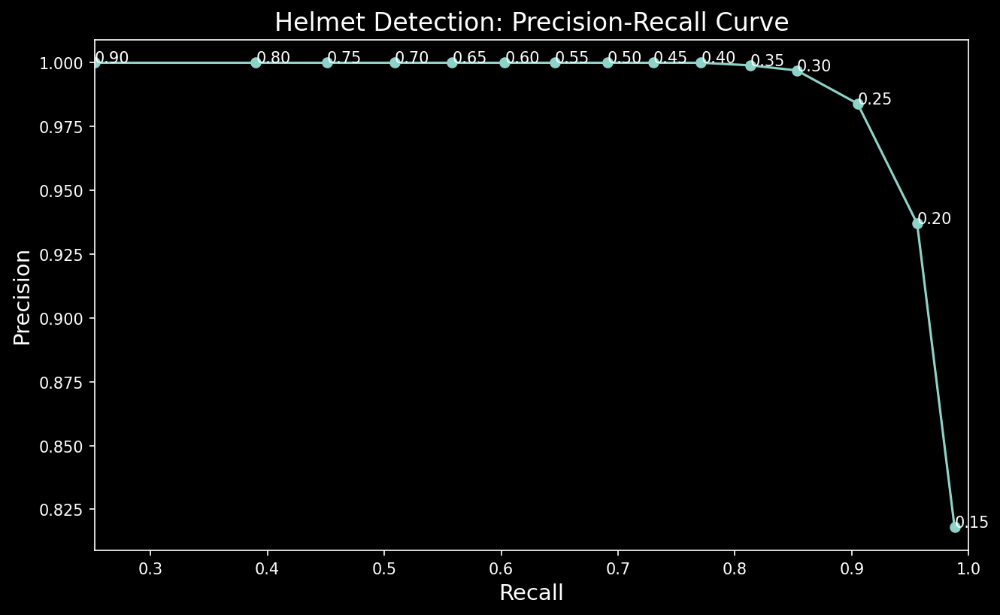

In [76]:
#Plot Precision-Recall Curve for Helmet Detection
with plt.style.context('dark_background'):
    plt.figure(figsize=(10, 6))
    plt.plot(recall_list, precision_list)
    plt.scatter(recall_list, precision_list)
    for i, name in enumerate(names):
        plt.annotate(name, (recall_list[i], precision_list[i]))
    plt.title("Helmet Detection: Precision-Recall Curve", fontsize=16)
    plt.xlim(min(recall_list), 1.0)
    plt.xlabel('Recall', fontsize=14)
    plt.ylabel('Precision', fontsize=14)
    plt.savefig('saved_images/prec_rec_curve.png')
    plt.show()

In [77]:
# #Plot Precision-Recall curve for Impact Detection
# with plt.style.context('dark_background'):
#     plt.figure(figsize=(10, 6))
#     plt.plot(recall_list_impacts, precision_list_impacts)
#     plt.scatter(recall_list_impacts, precision_list_impacts)
#     for i, name in enumerate(names):
#         plt.annotate(name, (recall_list_impacts[i], precision_list_impacts[i]))
#     plt.title("Impact Detection: Precision-Recall Curve", fontsize=16)
#     plt.xlim(min(recall_list_impacts), 1.0)
#     plt.xlabel('Recall', fontsize=14)
#     plt.ylabel('Precision', fontsize=14)
#     plt.show()

In [78]:
#Determine threshold level with highest F1 Score
precision_max = max(range(len(precision_list)), key=precision_list.__getitem__)
recall_max = max(range(len(recall_list)), key=recall_list.__getitem__)
f1_max = max(range(len(f1_score_list)), key=f1_score_list.__getitem__)
print("The confidence threshold with the highest Precision of {} for bounding boxes is {}".format(
    round(max(precision_list), 3), names[precision_max]))
print("The confidence threshold with the highest Recall of {} for bounding boxes is {}".format(
    round(max(recall_list), 3), names[recall_max]))
print("The confidence threshold with the highest F1 Score of {} for bounding boxes is {}".format(
    round(max(f1_score_list), 3), names[f1_max]))

The confidence threshold with the highest Precision of 1.0 for bounding boxes is 0.40
The confidence threshold with the highest Recall of 0.988 for bounding boxes is 0.15
The confidence threshold with the highest F1 Score of 0.946 for bounding boxes is 0.20


In [79]:
#Determine threshold level with highest F1 Score
precision_max_impacts = max(range(len(precision_list_impacts)), key=precision_list_impacts.__getitem__)
recall_max_impacts = max(range(len(recall_list_impacts)), key=recall_list_impacts.__getitem__)
f1_max_impacts = max(range(len(f1_score_list_impacts)), key=f1_score_list_impacts.__getitem__)
print("The confidence threshold with the highest Precision of {} for impacts is {}".format(
    round(max(precision_list_impacts), 3), names[precision_max_impacts][-3:]))
print("The confidence threshold with the highest Recall of {} for impacts is {}".format(
    round(max(recall_list_impacts), 3), names[recall_max_impacts][-3:]))
print("The confidence threshold with the highest F1 Score of {} for impacts is {}".format(
    round(max(f1_score_list_impacts), 3), names[f1_max_impacts][-3:]))

The confidence threshold with the highest Precision of 0.44 for impacts is .45
The confidence threshold with the highest Recall of 0.076 for impacts is .15
The confidence threshold with the highest F1 Score of 0.126 for impacts is .15


In [80]:
threshold_16 = final_test_df[final_test_df['scores'] >= 0.16]
threshold_16['counts'] = threshold_16.groupby(['pic_id'])['pic_id'].transform('count')
threshold_17 = final_test_df[final_test_df['scores'] >= 0.17]
threshold_17['counts'] = threshold_17.groupby(['pic_id'])['pic_id'].transform('count')
threshold_18 = final_test_df[final_test_df['scores'] >= 0.18]
threshold_18['counts'] = threshold_18.groupby(['pic_id'])['pic_id'].transform('count')
threshold_19 = final_test_df[final_test_df['scores'] >= 0.19]
threshold_19['counts'] = threshold_19.groupby(['pic_id'])['pic_id'].transform('count')
threshold_20 = final_test_df[final_test_df['scores'] >= 0.20]
threshold_20['counts'] = threshold_20.groupby(['pic_id'])['pic_id'].transform('count')
threshold_21 = final_test_df[final_test_df['scores'] >= 0.21]
threshold_21['counts'] = threshold_21.groupby(['pic_id'])['pic_id'].transform('count')
threshold_22 = final_test_df[final_test_df['scores'] >= 0.22]
threshold_22['counts'] = threshold_22.groupby(['pic_id'])['pic_id'].transform('count')
threshold_23 = final_test_df[final_test_df['scores'] >= 0.23]
threshold_23['counts'] = threshold_23.groupby(['pic_id'])['pic_id'].transform('count')
threshold_24 = final_test_df[final_test_df['scores'] >= 0.24]
threshold_24['counts'] = threshold_24.groupby(['pic_id'])['pic_id'].transform('count')

In [81]:
#List of threshold dataframes
thresholds = [threshold_16, threshold_17, threshold_18, threshold_19, threshold_20, 
              threshold_21, threshold_22, threshold_23, threshold_24]
#List of threshold names
names = ["0.16", "0.17", "0.18", "0.19", "0.20", "0.21", "0.22", "0.23", "0.24"]

residual_scores(thresholds, names)

In [82]:
precision_list = residual_scores.precision_list
recall_list = residual_scores.recall_list
f1_score_list = residual_scores.f1_score_list
precision_list_impacts = residual_scores.precision_list_impacts
recall_list_impacts = residual_scores.recall_list_impacts
f1_score_list_impacts = residual_scores.f1_score_list_impacts

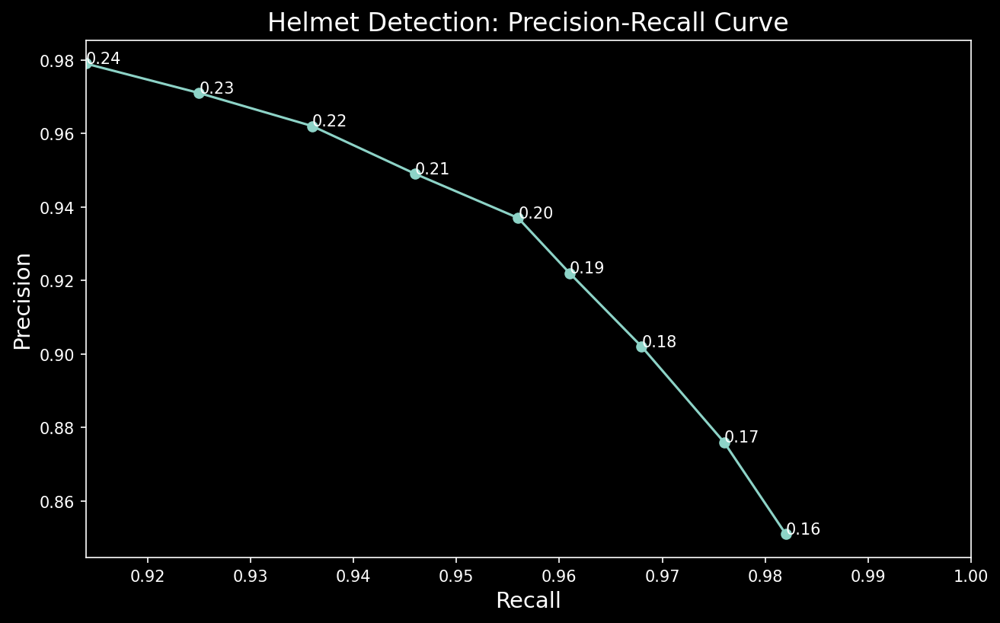

In [83]:
#Plot Precision-Recall Curve for Helmet Detection
with plt.style.context('dark_background'):
    plt.figure(figsize=(10, 6))
    plt.plot(recall_list, precision_list)
    plt.scatter(recall_list, precision_list)
    for i, name in enumerate(names):
        plt.annotate(name, (recall_list[i], precision_list[i]))
    plt.title("Helmet Detection: Precision-Recall Curve", fontsize=16)
    plt.xlim(min(recall_list), 1.0)
    plt.xlabel('Recall', fontsize=14)
    plt.ylabel('Precision', fontsize=14)
    plt.savefig('saved_images/prec_rec_curve2.png')
    plt.show()

In [84]:
#Determine threshold level with highest F1 Score
precision_max = max(range(len(precision_list)), key=precision_list.__getitem__)
recall_max = max(range(len(recall_list)), key=recall_list.__getitem__)
f1_max = max(range(len(f1_score_list)), key=f1_score_list.__getitem__)
print("The confidence threshold with the highest Precision of {} for bounding boxes is {}".format(
    round(max(precision_list), 3), names[precision_max][-3:]))
print("The confidence threshold with the highest Recall of {} for bounding boxes is {}".format(
    round(max(recall_list), 3), names[recall_max][-3:]))
print("The confidence threshold with the highest F1 Score of {} for bounding boxes is {}".format(
    round(max(f1_score_list), 3), names[f1_max][-3:]))

The confidence threshold with the highest Precision of 0.979 for bounding boxes is .24
The confidence threshold with the highest Recall of 0.982 for bounding boxes is .16
The confidence threshold with the highest F1 Score of 0.949 for bounding boxes is .22


The recommended metric in the competition is the F1 Score. This makes sense as the harmonic balance between precision and recall, and there is not a preference between reducing false positives or false negatives in this case. The best confidence threshold with the highest F1 Score is 0.22, so this is the threshold that will be used for visualizing detections. First, we need to rebuild the test dataset dataframe with the new confidence threshold.

In [85]:
final_test_df[final_test_df['scores'] >= np.float(names[f1_max])].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4273 entries, 0 to 5298
Data columns (total 13 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   gameKey  4273 non-null   int64  
 1   playID   4273 non-null   int64  
 2   video    4273 non-null   object 
 3   frame    4273 non-null   int64  
 4   left     4273 non-null   float64
 5   top      4273 non-null   float64
 6   right    4273 non-null   float64
 7   bottom   4273 non-null   float64
 8   impact   4273 non-null   float64
 9   scores   4273 non-null   float64
 10  pic_id   4273 non-null   object 
 11  view     4273 non-null   object 
 12  counts   4273 non-null   int64  
dtypes: float64(6), int64(4), object(3)
memory usage: 467.4+ KB


In [86]:
#Prepare image and detections for inference
final_test_df = final_test_df[final_test_df['scores'] >= np.float(names[f1_max])]

In [87]:
#Change impact to float
final_test_df['impact'] = final_test_df['impact'].astype(float)
#View impact value counts
final_test_df.impact.value_counts()

0.0    4237
1.0      36
Name: impact, dtype: int64

In [88]:
#Set impact to float
y_test_df = y_test_df.fillna(0.0)
y_test_df['impact'] = y_test_df['labels'].astype(float)
y_test_df.impact.value_counts()

0.0    4116
1.0     276
Name: impact, dtype: int64

We can see that the total number of helmet detections is much closer to the ground truth count. Impacts are still low as expected.

In [89]:
final_test_endzone = final_test_df[final_test_df['view'] == 'Endzone']
final_test_sideline = final_test_df[final_test_df['view'] == 'Sideline']
y_test_endzone = y_test_df[y_test_df['view'] == 'Endzone']
y_test_sideline = y_test_df[y_test_df['view'] == 'Sideline']

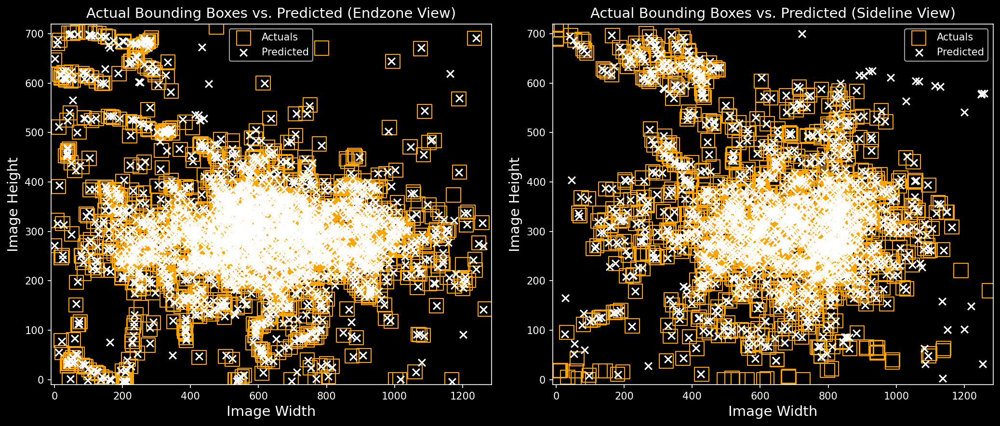

In [90]:
#Plot Actual vs. Predicted Bounding Boxes
with plt.style.context('dark_background'):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))
    axes[0].set_title("Actual Bounding Boxes vs. Predicted (Endzone View)", fontsize=14)
    axes[0].scatter(y_test_endzone.left, y_test_endzone.top,
                    marker='s', 
                    s=200,
                    edgecolors='orange', 
                    facecolors='none', 
                    label='Actuals')
    axes[0].scatter(final_test_endzone.left, final_test_endzone.top,  
                    marker='x', 
                    s=50, 
                    facecolors='white',
                    edgecolors = 'white',
                    label='Predicted')
    axes[0].set_xlabel("Image Width", fontsize=14)
    axes[0].set_ylabel("Image Height", fontsize=14)
    axes[0].set_xlim(-10, 1285)
    axes[0].set_ylim(-10, 720)
    axes[0].legend()

    #Plot Actual vs. Predicted Bounding Boxes
    axes[1].set_title("Actual Bounding Boxes vs. Predicted (Sideline View)", fontsize=14)
    axes[1].scatter(y_test_sideline.left, y_test_sideline.top,  
                    marker='s', 
                    s=200,
                    edgecolors='orange', 
                    facecolors='none', 
                    label='Actuals')
    axes[1].scatter(final_test_sideline.left, final_test_sideline.top,
                    marker='x',
                    s=50, 
                    facecolors='white',
                    edgecolors = 'white',
                    label='Predicted')
    axes[1].set_xlabel("Image Width", fontsize=14)
    axes[1].set_ylabel("Image Height", fontsize=14)
    axes[1].set_xlim(-10, 1285)
    axes[1].set_ylim(-10, 720)
    axes[1].legend()
    plt.tight_layout()
    plt.savefig('saved_images/act_vs_pred_scatter.png')
    plt.show()

As expected, it's clear that there are still false positives and false negatives. At this point, one of a few ways to improve this would be to add more data.

In [91]:
y_test_endzone_impacts = y_test_endzone[y_test_endzone['impact'] == 1.0]
final_test_endzone_impacts = final_test_endzone[final_test_endzone['impact'] == 1.0]

y_test_sideline_impacts = y_test_sideline[y_test_sideline['impact'] == 1.0]
final_test_sideline_impacts = final_test_sideline[final_test_sideline['impact'] == 1.0]

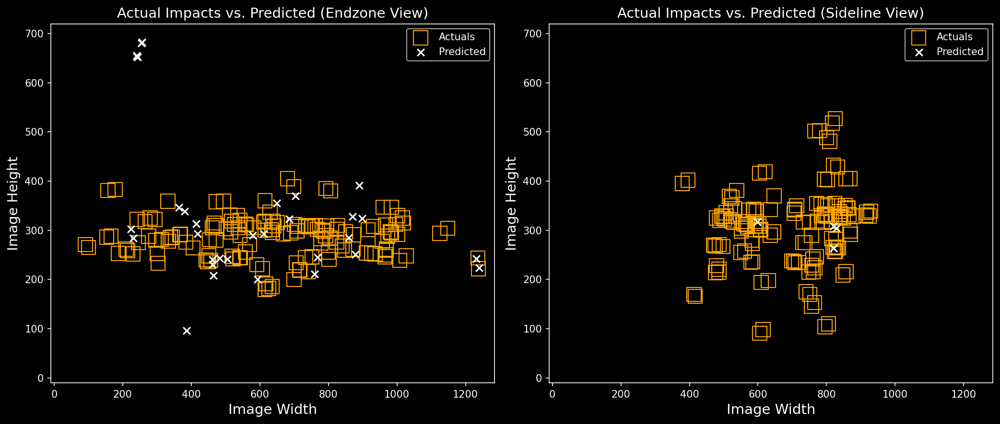

In [92]:
#Plot Actual vs. Predicted Bounding Boxes
with plt.style.context('dark_background'):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))
    axes[0].set_title("Actual Impacts vs. Predicted (Endzone View)", fontsize=14)
    marker_style = dict(color='orange', marker='o',
                        markersize=50, fillstyle='none')
    axes[0].scatter(y_test_endzone_impacts.left, y_test_endzone_impacts.top,
                    marker='s', 
                    s=200, 
                    edgecolors='orange', 
                    facecolors='none', 
                    label='Actuals')
    axes[0].scatter(final_test_endzone_impacts.left, final_test_endzone_impacts.top,  
                    marker='x', 
                    s=50, 
                    edgecolors = 'white',
                    facecolors='white',
                    label='Predicted')
    axes[0].set_xlabel("Image Width", fontsize=14)
    axes[0].set_ylabel("Image Height", fontsize=14)
    axes[0].set_xlim(-10, 1285)
    axes[0].set_ylim(-10, 720)
    axes[0].legend()

    #Plot Actual vs. Predicted Bounding Boxes
    axes[1].set_title("Actual Impacts vs. Predicted (Sideline View)", fontsize=14)
    marker_style = dict(color='orange', marker='o',
                        markersize=50, fillstyle='none')
    axes[1].scatter(y_test_sideline_impacts.left, y_test_sideline_impacts.top, 
                    marker='s', 
                    s=200,
                    edgecolors='orange', 
                    facecolors='none', 
                    label='Actuals')
    axes[1].scatter(final_test_sideline_impacts.left, final_test_sideline_impacts.top,  
                    marker='x', 
                    s=50, 
                    facecolors='white',
                    edgecolors = 'white',
                    label='Predicted')
    axes[1].set_xlabel("Image Width", fontsize=14)
    axes[1].set_ylabel("Image Height", fontsize=14)
    axes[1].set_xlim(-10, 1285)
    axes[1].set_ylim(-10, 720)
    axes[1].legend()
    plt.tight_layout()
    plt.savefig('saved_images/act_vs_pred_impacts.png')
    plt.show()

Impact results are less than satisfactory, which indicates further work is absolutely necessary.

# Visualize Detections in Images

In [93]:
#Prepare image and detections for inference
image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)
detections = DecodePredictions()(image, predictions)
inference_model = tf.keras.Model(inputs=image, outputs=detections)

tf.Tensor(b'577873413129.png', shape=(), dtype=string)


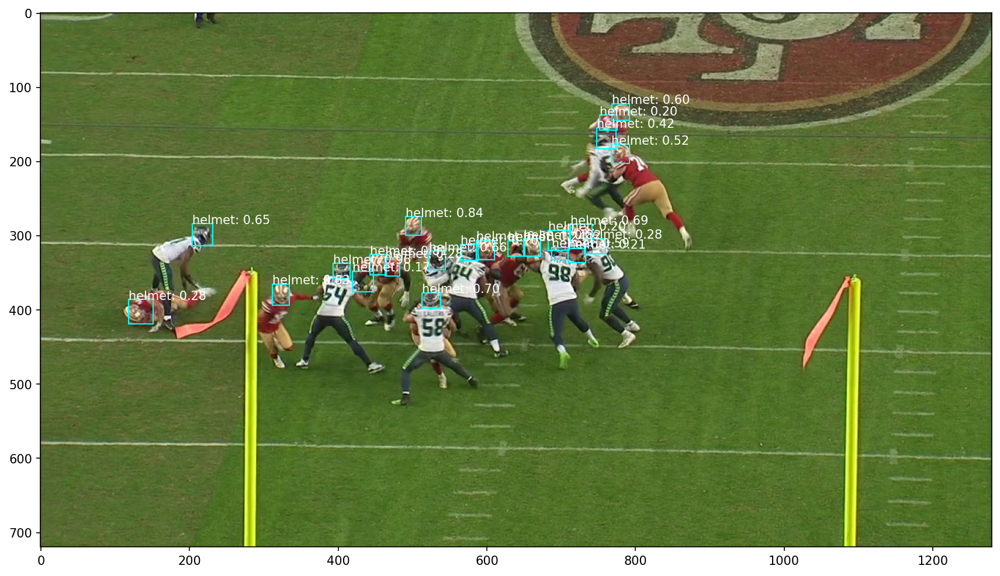

tf.Tensor(b'5759765866.png', shape=(), dtype=string)


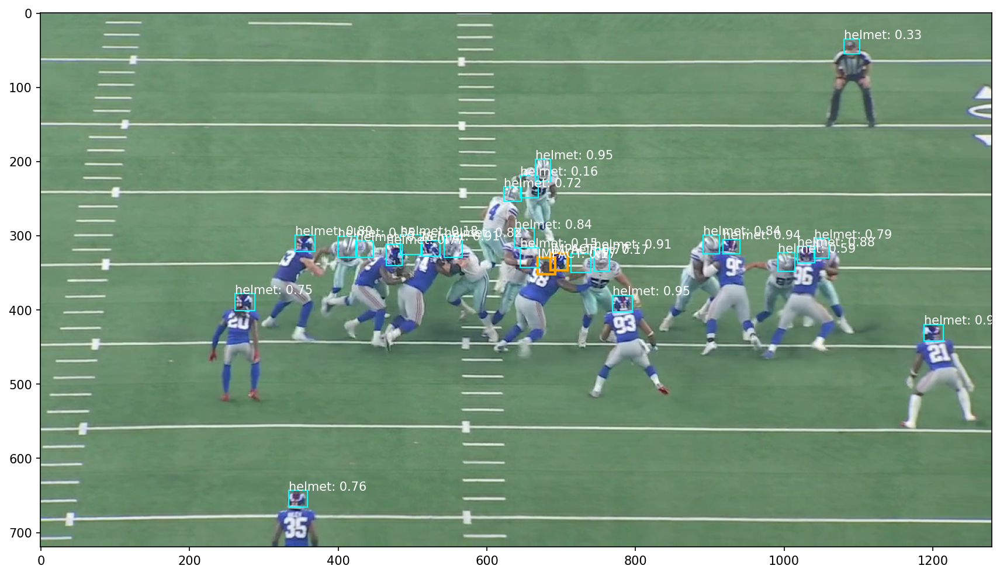

tf.Tensor(b'579153093326789.png', shape=(), dtype=string)


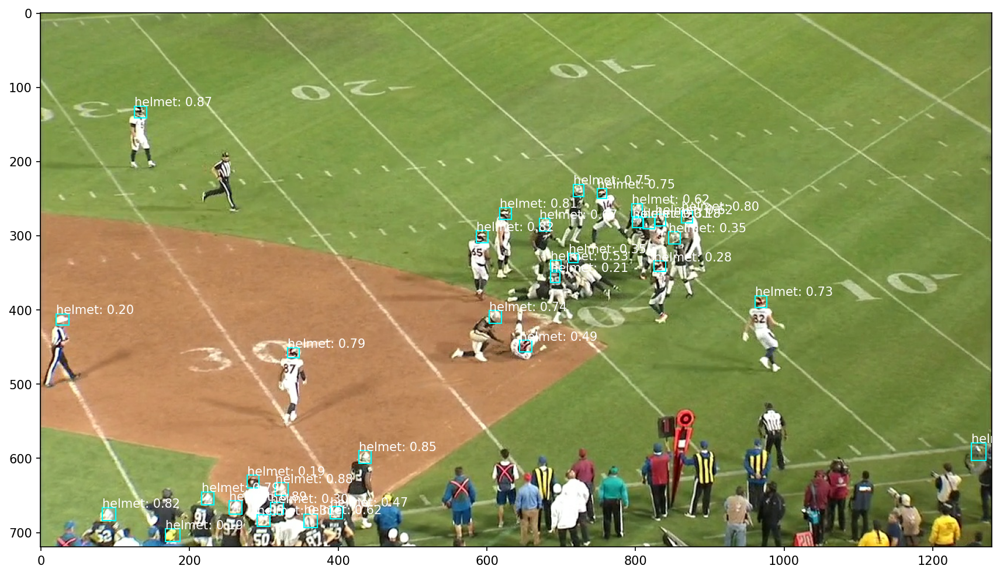

tf.Tensor(b'57992301259.png', shape=(), dtype=string)


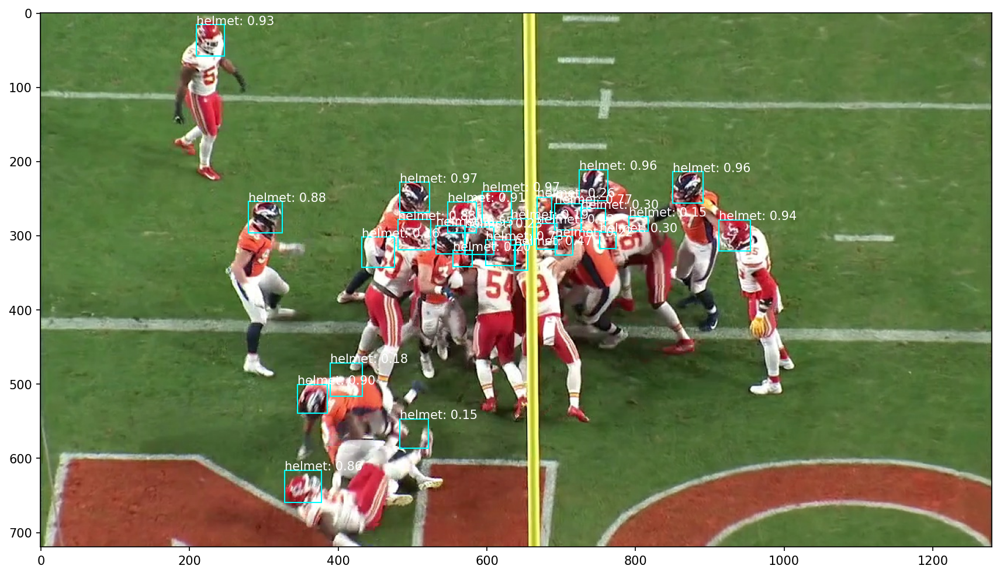

tf.Tensor(b'57905240468789.png', shape=(), dtype=string)


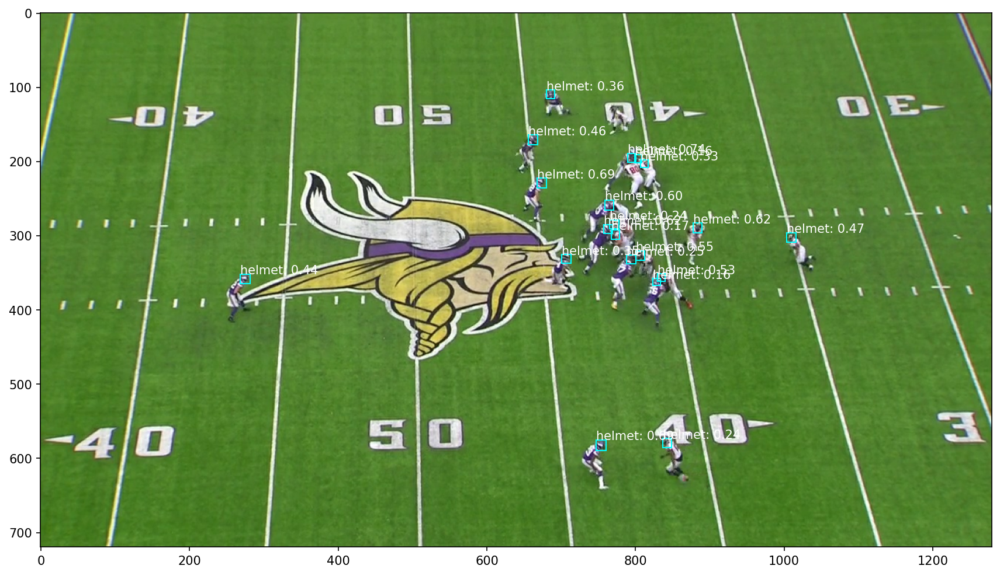

In [94]:
for sample in test_dataset.take(5):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    boxes_reshaped = tf.reshape(detections[0], [-1, 4])
    num_detections, selected_scores = tf.image.non_max_suppression_with_scores(
        boxes=boxes_reshaped, scores=detections[1].reshape(-1), max_output_size=max_output, iou_threshold=iou_threshold,
        score_threshold=score_threshold, soft_nms_sigma=soft_nms)
    boxes = []
    for num in num_detections.numpy():
        boxes.append(boxes_reshaped.numpy()[num])
    boxes = np.array(boxes)
    scores = selected_scores.numpy()
    num_detections = len(num_detections)
    print(sample["image/filename"])
    labels = scores.tolist()
    for i, j in enumerate(labels):
        if j == 0.:
            labels[i] = 'helmet'
        else:
            labels[i] = 'none'
    class_names = labels
    visualize_detections(
        image = image,
        boxes = boxes,
        classes = class_names,
        scores = scores,
        min_iou=min_iou,
        max_iou=max_iou
    )

# Predicting Detections on Unseen Test Videos

In [95]:
#Establish video directories
endzone_path = "gs://nfl-object-detection123/test_vid/endzone.tfrecord"
sideline_path = "gs://nfl-object-detection123/test_vid/sideline.tfrecord"

In [96]:
#Load prebuilt TFRecords from the preprocessing notebook
endzone_tf_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(endzone_path))
sideline_tf_dataset = tf.data.TFRecordDataset(tf.io.gfile.glob(sideline_path))

In [97]:
def parse_final(tfrecord):
    "Parse the features of a tensorflow record into a dictionary."
    
    features={
    'image': tf.io.FixedLenFeature([], tf.string),
    }
    
    sample = tf.io.parse_example(tfrecord, features)
    image = tf.image.decode_png(sample['image'], channels=3)
    
    image_dict = {"image": image}
    
    return image_dict

In [98]:
#Parse both tfrecords
endzone_tf_dataset = endzone_tf_dataset.map(parse_final)
sideline_tf_dataset = sideline_tf_dataset.map(parse_final)

In [99]:
#Capture arrays from tfrecord
endzone_arrays = []
for i in tqdm.tqdm_notebook(endzone_tf_dataset):
    endzone_arrays.append(i['image'].numpy())

In [100]:
#Capture arrays from tfrecord
sideline_arrays = []
for i in tqdm.tqdm_notebook(sideline_tf_dataset):
    sideline_arrays.append(i['image'].numpy())

In [101]:
#Convert to array
endzone_video_array = np.array(endzone_arrays)
sideline_video_array = np.array(sideline_arrays)

In [102]:
#Preview shape
endzone_video_array.shape

(472, 720, 1280, 3)

In [103]:
#Preview shape
sideline_video_array.shape

(471, 720, 1280, 3)

In [104]:
# Define the path and then display the video using 
endzone_vid_path = "gs://nfl-object-detection123/test_vid/57583_000082_Endzone.mp4"
sideline_vid_path = "gs://nfl-object-detection123/test_vid/57583_000082_Sideline.mp4"

In [131]:
#Build final_dataframe of the arrays
score_threshold = np.float(names[f1_max])
min_iou = 0.1
max_iou = 0.4
final_dataframe(endzone_video_array,
                max_output=max_output, 
                iou_threshold=iou_threshold, 
                score_threshold=score_threshold, 
                soft_nms=soft_nms, 
                min_iou=min_iou,
                max_iou=max_iou)

,gameKey,playID,video,frame,left,top,right,bottom,impact,scores,pic_id,view
0,NaN,NaN,NaN,0,723.392151,226.418137,745.128601,251.595291,0.0,0.953531,NaN,0
1,NaN,NaN,NaN,0,1071.575317,297.480255,1096.028442,318.209625,0.0,0.952815,NaN,0
2,NaN,NaN,NaN,0,961.511902,233.139130,983.499817,260.728943,0.0,0.942119,NaN,0
3,NaN,NaN,NaN,0,554.700867,327.738251,578.580017,347.310455,0.0,0.909944,NaN,0
4,NaN,NaN,NaN,0,882.646851,180.398163,903.538086,208.141418,0.0,0.900214,NaN,0


In [132]:
#Create video column
final_endzone_df = final_dataframe.solution_df
final_endzone_df['video'] = endzone_vid_path.lstrip('gs://nfl-object-detection123/test_vid/')

In [133]:
#Drop unnecessary columns
final_endzone_df = final_endzone_df.drop(columns=['gameKey', 'playID', 'pic_id'])

#Fill missing values
final_endzone_df["impact"] = final_endzone_df.impact.fillna(0.0)

#Convert impact to float
final_endzone_df["impact"] = final_endzone_df.impact.astype(float)

#Preview head
display(final_endzone_df.head())

#View impact counts
final_endzone_df.impact.value_counts()

,video,frame,left,top,right,bottom,impact,scores,view
0,57583_000082_Endzone.mp4,0,723.392151,226.418137,745.128601,251.595291,0.0,0.953531,0
1,57583_000082_Endzone.mp4,0,1071.575317,297.480255,1096.028442,318.209625,0.0,0.952815,0
2,57583_000082_Endzone.mp4,0,961.511902,233.139130,983.499817,260.728943,0.0,0.942119,0
3,57583_000082_Endzone.mp4,0,554.700867,327.738251,578.580017,347.310455,0.0,0.909944,0
4,57583_000082_Endzone.mp4,0,882.646851,180.398163,903.538086,208.141418,0.0,0.900214,0


0.0    8872
1.0      38
Name: impact, dtype: int64

In [134]:
#Filter impacts as described above
video_labels = video_labels.fillna(0.0)
video_labels.loc[(video_labels.impact == 1) 
                     & (video_labels.impactType != 'Helmet'), ['impact']] = 0.0
video_labels.loc[(video_labels.confidence <= 1), ['impact']] = 0.0
video_labels.loc[(video_labels.visibility == 0), ['impact']] = 0.0

In [135]:
video_labels[video_labels['video'] == final_endzone_df.video.values[0]]

,gameKey,playID,view,video,frame,label,left,width,top,height,impact,impactType,confidence,visibility
0,57583,82,Endzone,57583_000082_Endzone.mp4,1,H30,629,19,40,24,0.0,0,0.0,0.0
1,57583,82,Endzone,57583_000082_Endzone.mp4,1,V72,443,22,344,16,0.0,0,0.0,0.0
2,57583,82,Endzone,57583_000082_Endzone.mp4,1,V86,871,21,359,17,0.0,0,0.0,0.0
3,57583,82,Endzone,57583_000082_Endzone.mp4,1,V74,771,19,345,15,0.0,0,0.0,0.0
4,57583,82,Endzone,57583_000082_Endzone.mp4,1,V34,549,26,461,20,0.0,0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8507,57583,82,Endzone,57583_000082_Endzone.mp4,472,H50,1070,35,263,38,0.0,0,0.0,0.0
8508,57583,82,Endzone,57583_000082_Endzone.mp4,472,H30,353,32,49,28,0.0,0,0.0,0.0
8509,57583,82,Endzone,57583_000082_Endzone.mp4,472,V86,304,39,212,36,0.0,0,0.0,0.0
8510,57583,82,Endzone,57583_000082_Endzone.mp4,472,H90,497,33,234,34,0.0,0,0.0,0.0


In [136]:
video_labels[video_labels['video'] == final_endzone_df.video.values[0]]['impact'].value_counts()

0.0    8500
1.0      12
Name: impact, dtype: int64

### Building a final dataframe for the matching sideline video.

In [137]:
#Build final_dataframe of the arrays
min_iou = .1
max_iou = .4
final_dataframe(sideline_video_array,
                max_output=max_output, 
                iou_threshold=iou_threshold, 
                score_threshold=score_threshold, 
                soft_nms=soft_nms, 
                min_iou=min_iou,
                max_iou=max_iou)

,gameKey,playID,video,frame,left,top,right,bottom,impact,scores,pic_id,view
0,NaN,NaN,NaN,0,612.745361,373.237061,627.859619,388.971313,0.0,0.928675,NaN,0
1,NaN,NaN,NaN,0,410.999298,310.091309,425.008636,324.405945,0.0,0.895694,NaN,0
2,NaN,NaN,NaN,0,350.707672,387.434906,364.963837,402.467987,0.0,0.812707,NaN,0
3,NaN,NaN,NaN,0,640.569824,318.949127,656.368164,336.015900,0.0,0.790786,NaN,0
4,NaN,NaN,NaN,0,523.550354,408.137451,538.083557,422.384277,0.0,0.757245,NaN,0


In [138]:
#Create video column
final_sideline_df = final_dataframe.solution_df
final_sideline_df['video'] = sideline_vid_path.lstrip('gs://nfl-object-detection123/test_vid/')

In [139]:
#Drop unnecessary columns
final_sideline_df = final_sideline_df.drop(columns=['gameKey', 'playID', 'pic_id'])

#Fill missing values
final_sideline_df["impact"] = final_sideline_df.impact.fillna(0.0)

#Convert impact to float
final_sideline_df["impact"] = final_sideline_df.impact.astype(float)

#Preview head
display(final_sideline_df.head())

#View impact counts
final_sideline_df.impact.value_counts()

,video,frame,left,top,right,bottom,impact,scores,view
0,57583_000082_Sideline.mp4,0,612.745361,373.237061,627.859619,388.971313,0.0,0.928675,0
1,57583_000082_Sideline.mp4,0,410.999298,310.091309,425.008636,324.405945,0.0,0.895694,0
2,57583_000082_Sideline.mp4,0,350.707672,387.434906,364.963837,402.467987,0.0,0.812707,0
3,57583_000082_Sideline.mp4,0,640.569824,318.949127,656.368164,336.015900,0.0,0.790786,0
4,57583_000082_Sideline.mp4,0,523.550354,408.137451,538.083557,422.384277,0.0,0.757245,0


0.0    9471
1.0      10
Name: impact, dtype: int64

In [140]:
video_labels[video_labels['video'] == final_sideline_df.video.values[0]]['impact'].value_counts()

0.0    9785
1.0      12
Name: impact, dtype: int64

In [141]:
final_sideline_df = final_sideline_df.fillna(0.0)
final_endzone_df = final_endzone_df.fillna(0.0)

In [142]:
final_endzone_actuals = video_labels[video_labels['video'] == final_endzone_df.video.values[0]]
final_endzone_actuals.head()

,gameKey,playID,view,video,frame,label,left,width,top,height,impact,impactType,confidence,visibility
0,57583,82,Endzone,57583_000082_Endzone.mp4,1,H30,629,19,40,24,0.0,0,0.0,0.0
1,57583,82,Endzone,57583_000082_Endzone.mp4,1,V72,443,22,344,16,0.0,0,0.0,0.0
2,57583,82,Endzone,57583_000082_Endzone.mp4,1,V86,871,21,359,17,0.0,0,0.0,0.0
3,57583,82,Endzone,57583_000082_Endzone.mp4,1,V74,771,19,345,15,0.0,0,0.0,0.0
4,57583,82,Endzone,57583_000082_Endzone.mp4,1,V34,549,26,461,20,0.0,0,0.0,0.0


In [143]:
final_sideline_actuals = video_labels[video_labels['video'] == final_sideline_df.video.values[0]]
final_sideline_actuals.head()

,gameKey,playID,view,video,frame,label,left,width,top,height,impact,impactType,confidence,visibility
8512,57583,82,Sideline,57583_000082_Sideline.mp4,1,H30,956,15,357,13,0.0,0,0.0,0.0
8513,57583,82,Sideline,57583_000082_Sideline.mp4,1,V72,450,13,306,12,0.0,0,0.0,0.0
8514,57583,82,Sideline,57583_000082_Sideline.mp4,1,V74,401,11,373,13,0.0,0,0.0,0.0
8515,57583,82,Sideline,57583_000082_Sideline.mp4,1,V86,352,14,388,15,0.0,0,0.0,0.0
8516,57583,82,Sideline,57583_000082_Sideline.mp4,1,V87,343,14,408,13,0.0,0,0.0,0.0


In [144]:
final_endzone_actuals = final_endzone_actuals.fillna(0.0)
final_sideline_actuals = final_sideline_actuals.fillna(0.0)

In [172]:
# final_endzone_actuals['frame'] = final_endzone_actuals.frame - 1
# final_sideline_actuals['frame'] = final_sideline_actuals.frame - 1

In [173]:
final_endzone_actuals['pic_id'] = final_endzone_actuals.frame.astype(str) + ".png"
final_sideline_actuals['pic_id'] = final_sideline_actuals.frame.astype(str) + ".png"

In [147]:
final_endzone_actuals['counts'] = final_endzone_actuals.groupby(['pic_id'])['pic_id'].transform('count')
final_sideline_actuals['counts'] = final_sideline_actuals.groupby(['pic_id'])['pic_id'].transform('count')

In [148]:
final_endzone_df['pic_id'] = final_endzone_df.frame.astype(str) + ".png"
final_sideline_df['pic_id'] = final_sideline_df.frame.astype(str) + ".png"

In [149]:
final_endzone_df['counts'] = final_endzone_df.groupby(['pic_id'])['pic_id'].transform('count')
final_sideline_df['counts'] = final_sideline_df.groupby(['pic_id'])['pic_id'].transform('count')

In [150]:
final_endzone_actuals.loc[(final_endzone_actuals.impact == 1) 
                     & (final_endzone_actuals.impactType != 'Helmet'), ['impact']] = 0.0
final_endzone_actuals.loc[(final_endzone_actuals.confidence <= 1), ['impact']] = 0.0
final_endzone_actuals.loc[(final_endzone_actuals.visibility == 0), ['impact']] = 0.0

final_sideline_actuals.loc[(final_sideline_actuals.impact == 1) 
                     & (final_sideline_actuals.impactType != 'Helmet'), ['impact']] = 0.0
final_sideline_actuals.loc[(final_sideline_actuals.confidence <= 1), ['impact']] = 0.0
final_sideline_actuals.loc[(final_sideline_actuals.visibility == 0), ['impact']] = 0.0

In [151]:
final_endzone_actuals['right'] = (final_endzone_actuals.left + final_endzone_actuals.width).astype(float)
final_endzone_actuals['bottom'] = (final_endzone_actuals.top + final_endzone_actuals.height).astype(float)

final_sideline_actuals['right'] = (final_sideline_actuals.left + final_sideline_actuals.width).astype(float)
final_sideline_actuals['bottom'] = (final_sideline_actuals.top + final_sideline_actuals.height).astype(float)

In [178]:
build_residual_df(final_endzone_df, final_endzone_actuals, name=names[f1_max])

In [179]:
print("Endzone Precision:", build_residual_df.total_precision)
print("Endzone Recall:", build_residual_df.total_recall)
print("Endzone F1 Score:", build_residual_df.total_f1_score)
print("Endzone Impact Precision:", build_residual_df.total_precision_impacts)
print("Endzone Impact Recall:", build_residual_df.total_recall_impacts)
print("Endzone Impact F1 Score:", build_residual_df.total_f1_score_impacts)

Endzone Precision: 0.936
Endzone Recall: 0.979
Endzone F1 Score: 0.9570172323759791
Endzone Impact Precision: 0.053
Endzone Impact Recall: 0.167
Endzone Impact F1 Score: 0.08046363636363636


In [180]:
build_residual_df(final_sideline_df, final_sideline_actuals, name=names[f1_max])

In [181]:
print("Sideline Precision:", build_residual_df.total_precision)
print("Sideline Recall:", build_residual_df.total_recall)
print("Sideline F1 Score:", build_residual_df.total_f1_score)
print("Sideline Impact Precision:", build_residual_df.total_precision_impacts)
print("Sideline Impact Recall:", build_residual_df.total_recall_impacts)
print("Sideline Impact F1 Score:", build_residual_df.total_f1_score_impacts)

Sideline Precision: 0.976
Sideline Recall: 0.945
Sideline F1 Score: 0.9602498698594482
Sideline Impact Precision: 0.0
Sideline Impact Recall: 0.0
Sideline Impact F1 Score: nan


The F1 score for endzone helmet detection finished at 0.957 and 0.96 for sideline detections. Impacts were not as successful, as expected, finishing with an F1 Score of 0.08 for the endzone view and not detecting any correctly for the sideline view.

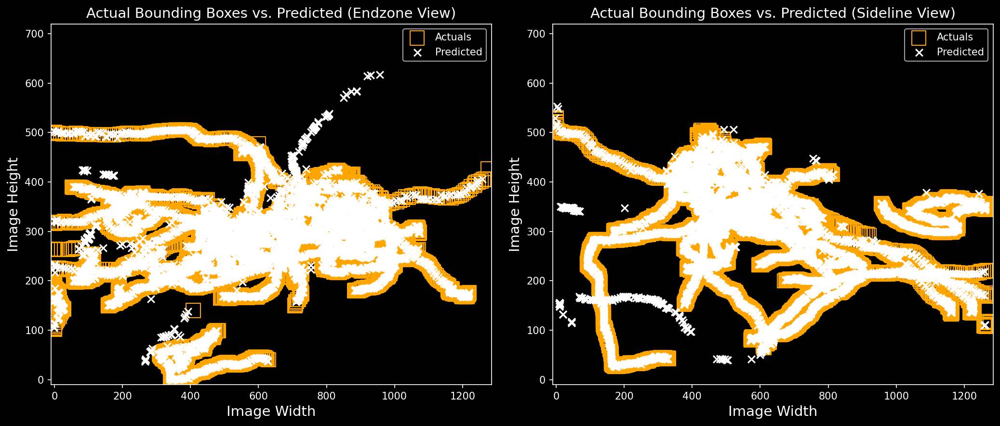

In [182]:
#Plot Actual vs. Predicted Bounding Boxes
with plt.style.context('dark_background'):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))
    axes[0].set_title("Actual Bounding Boxes vs. Predicted (Endzone View)", fontsize=14)
    marker_style = dict(color='orange', marker='o',
                        markersize=50, fillstyle='none')
    axes[0].scatter(final_endzone_actuals.left, final_endzone_actuals.top, 
                marker='s', 
                s=200,
                edgecolors='orange', 
                facecolors='none', 
                label='Actuals')
    axes[0].scatter(final_endzone_df.left, final_endzone_df.top, 
                marker='x', 
                s=50, 
                facecolors='white',
                edgecolors = 'white',
                label='Predicted')
    axes[0].set_xlabel("Image Width", fontsize=14)
    axes[0].set_ylabel("Image Height", fontsize=14)
    axes[0].set_xlim(-10, 1285)
    axes[0].set_ylim(-10, 720)
    axes[0].legend()

    #Plot Actual vs. Predicted Bounding Boxes
    axes[1].set_title("Actual Bounding Boxes vs. Predicted (Sideline View)", fontsize=14)
    marker_style = dict(color='orange', marker='o',
                        markersize=50, fillstyle='none')
    axes[1].scatter(final_sideline_actuals.left, final_sideline_actuals.top, 
                marker='s', 
                s=200,
                edgecolors='orange', 
                facecolors='none', 
                label='Actuals')
    axes[1].scatter(final_sideline_df.left, final_sideline_df.top, 
                marker='x', 
                s=50, 
                facecolors='white',
                edgecolors = 'white',
                label='Predicted')
    axes[1].set_xlabel("Image Width", fontsize=14)
    axes[1].set_ylabel("Image Height", fontsize=14)
    axes[1].set_xlim(-10, 1285)
    axes[1].set_ylim(-10, 720)
    axes[1].legend()
    plt.tight_layout()
    plt.savefig('saved_images/final_act_vs_pred.png')
    plt.show()

In [183]:
endzone_impacts = final_endzone_df[final_endzone_df['impact'] == 1]
final_endzone_actual_impacts = final_endzone_actuals[final_endzone_actuals['impact'] == 1]

sideline_impacts = final_sideline_df[final_sideline_df['impact'] == 1]
final_sideline_actual_impacts = final_sideline_actuals[final_sideline_actuals['impact'] == 1]

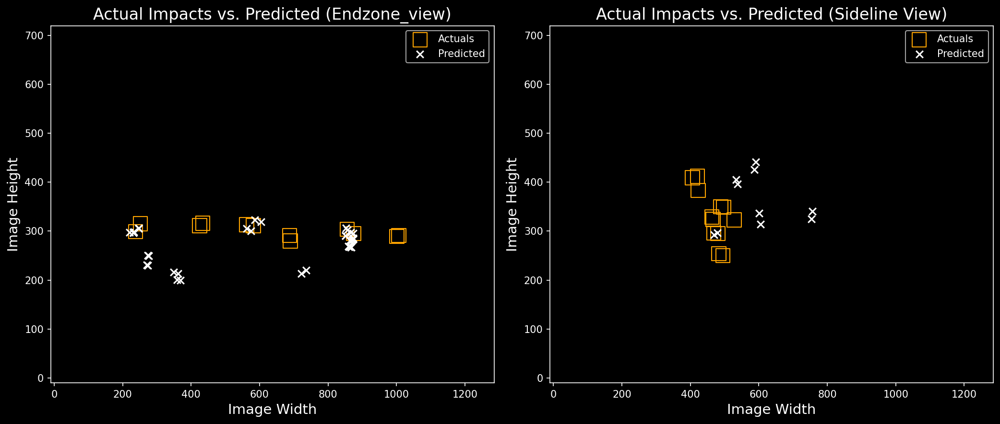

In [184]:
#Plot Actual vs. Predicted Impacts
with plt.style.context('dark_background'):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))
    axes[0].set_title("Actual Impacts vs. Predicted (Endzone_view)", fontsize=16)
    axes[0].scatter(final_endzone_actual_impacts.left, final_endzone_actual_impacts.top, 
                marker='s', 
                s=200,
                edgecolors='orange', 
                facecolors='none', 
                label='Actuals')
    axes[0].scatter(endzone_impacts.left, endzone_impacts.top, 
                marker='x', 
                s=50, 
                facecolors='white',
                edgecolors = 'white',
                label='Predicted')
    axes[0].set_xlabel("Image Width", fontsize=14)
    axes[0].set_ylabel("Image Height", fontsize=14)
    axes[0].set_xlim(-10, 1285)
    axes[0].set_ylim(-10, 720)
    axes[0].legend()

    #Plot Actual vs. Predicted Impacts
    axes[1].set_title("Actual Impacts vs. Predicted (Sideline View)", fontsize=16)
    axes[1].scatter(final_sideline_actual_impacts.left, final_sideline_actual_impacts.top, 
                marker='s', 
                s=200,
                edgecolors='orange', 
                facecolors='none', 
                label='Actuals')
    axes[1].scatter(sideline_impacts.left, sideline_impacts.top, 
                marker='x', 
                s=50, 
                facecolors='white',
                edgecolors = 'white',
                label='Predicted')
    axes[1].set_xlabel("Image Width", fontsize=14)
    axes[1].set_ylabel("Image Height", fontsize=14)
    axes[1].set_xlim(-10, 1285)
    axes[1].set_ylim(-10, 720)
    axes[1].legend()
    plt.tight_layout()
    plt.savefig('saved_images/final_act_vs_pred_impacts.png')
    plt.show()

# Visualizing Detections in Video

In [188]:
!mkdir 'final_endzone_images/'
!mkdir 'final_sideline_images/'

final_endzone_images = 'final_endzone_images/'
final_sideline_images = 'final_sideline_images/'

In [189]:
# Create a function to annotate the video at the provided path using labels from the provided dataframe, return the path of the video
def annotate_video(video_path: str, final_df: pd.DataFrame, test_video_array, img_output_path) -> str:
    
    """Annotate the video at the provided path using the prebuilt final_dataframe.
    Arguments:
      video_path: Specified video path to visualize.
      final_df: The dataframe built from the final_dataframe function.
      test_video_array: Image array of captured frames from videos.
      img_output_path: Path to write image files to.
    Returns: Video with bounding boxes for helmets and impacts."""
    
    #Determine appropriate video specs
    VIDEO_CODEC = "MP4V"
    HELMET_COLOR = (255, 255, 0) # Aqua
    IMPACT_COLOR = (1, 153, 255) # Orange
    video_name = os.path.basename(video_path)
    
    vidcap = cv2.VideoCapture(video_path)
    # Original fps was close to 60, but using 10 for a slow motion effect
    fps = 15
    annotate_video.fps = fps
    width = int(np.ceil(test_video_array.shape[2] / 3))
    height = int(np.ceil(test_video_array.shape[1] / 3))
    size = (width, height)
    output_path = "labeled_" + video_name
    tmp_output_path = "tmp_" + output_path
    output_video = cv2.VideoWriter(tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, size)

    #Write images to file and then read them into a video by frame
    for i, j in tqdm.tqdm_notebook(enumerate(test_video_array)):
        cv2.imwrite('{}/{}.png'.format(img_output_path, str(i)), j)
        img = cv2.imread('{}/{}.png'.format(img_output_path, str(i)))
        img = cv2.resize(img, (width, height), interpolation=cv2.INTER_CUBIC)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        frame = int(i)
        # Now, add the boxes
        boxes = final_df.query("frame == @frame")
        #Visualize the bounding boxes
        for box in boxes.itertuples(index=False):
            if box.impact == 1.0:    # Filter for definitive head impacts and turn labels red
                color, thickness = IMPACT_COLOR, 2
                text = ""
            else:
                color, thickness = HELMET_COLOR, 1
                text = ""
            # Add a box around the helmet
            start_point = (int(box.left/3), int(box.top/3))
            end_point = (int(box.right/3), int(box.bottom/3))
            cv2.rectangle(img, start_point, end_point, color, thickness)
            cv2.putText(img, text, (int(box.right/3), max(0, int(box.top/3) - 5)), 
                        cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, thickness)
        output_video.write(img)
    output_video.release()
       # Not all browsers support the codec, we will re-load the file at tmp_output_path and convert to a codec that is more broadly readable using ffmpeg
#     if os.path.exists(output_path):
#         os.remove(output_path)
    subprocess.run(["ffmpeg", "-i", tmp_output_path, "-crf", "18", "-preset", "veryfast", "-vcodec", "libx264", output_path])
#     os.remove(tmp_output_path)

    return output_path

In [190]:
# Label the video
endzone_labeled_video = annotate_video(endzone_vid_path, final_endzone_df, 
                                       endzone_video_array, final_endzone_images)
endzone_labeled_video = "tmp_" + endzone_labeled_video

# Label the video
sideline_labeled_video = annotate_video(sideline_vid_path, final_sideline_df, 
                                        sideline_video_array, final_sideline_images)
sideline_labeled_video = "tmp_" + sideline_labeled_video

In [191]:
#Show videos side by side
clip_1 = VideoFileClip(endzone_labeled_video)
clip_2 = VideoFileClip(sideline_labeled_video)
final_clip = [[clip_1, clip_2]]
final_clip = clips_array(final_clip)
final_clip.write_videofile("saved_images/final.mp4")

[MoviePy] >>>> Building video saved_images/final.mp4
[MoviePy] Writing video saved_images/final.mp4


100%|██████████| 473/473 [00:02<00:00, 188.80it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: saved_images/final.mp4 



In [192]:
final_video = 'saved_images/final.mp4'
display(Video(data=final_video, embed=True, width=1280))

# Conclusion

Although the model did reasonably well with detecting helmets with an F1 Score of on the test dataset, it is obvious that further work is necessary to improve the detection of helmet impacts.

Further work can include but is not limited to the following:
* Combining previous data with player tracking data and potentially using homography to locate players in videos based on tracking key points.
* Potentially using 3D Convolutional Neural Network models to identify impacts (computationally expensive).
* Using a Temporal Shift Module (the winner of the Kaggle competition used TSM). Videos have an additional dimension over images, the temporal dimension, which is the shift of objects in images between frames. Using this information, the TSM predicts actions based on a specified range of frames. This is a less computationally-expensive model as it only utilizes 2D CNNs. (With ResNet, this could be added after each convolutional block) https://www.youtube.com/watch?v=4BwXOcLqrGk.